## Train data for Random Forest

Training statistics and plotting data. This is long page (lot of images).

MatplotLib images: https://matplotlib.org/stable/users/explain/colors/colormaps.html 

In [5]:
import numpy as np
import os
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, recall_score, precision_score, precision_recall_curve, auc, cohen_kappa_score, confusion_matrix
from scipy.ndimage import binary_dilation
import csv
import matplotlib.pyplot as plt

In [ ]:
#Checking out the data type of the mask layer
# Directory where the Label3m_{}.npy files are located
label3m_dir = '../../01_Data/01_Raw/features/features'

# Loop through each Label3m_{}.npy file in the directory
for i in range(11, 22):  # Assuming the files are named Label3m_7.npy, Label3m_8.npy, ..., Label3m_12.npy
    mask_path = os.path.join(label3m_dir, f"Label3m_{i}.npy")  # Construct the path to each file
    
    # Load the mask
    mask_data = np.load(mask_path)
    
    # Print the unique values in the mask
    unique_values = np.unique(mask_data)
    print(f"Unique values in {mask_path}: {unique_values}")



Unique values in ../../01_Data/01_Raw/features/features\Label3m_11.npy: [False  True]
Unique values in ../../01_Data/01_Raw/features/features\Label3m_12.npy: [False  True]
Unique values in ../../01_Data/01_Raw/features/features\Label3m_13.npy: [False  True]
Unique values in ../../01_Data/01_Raw/features/features\Label3m_14.npy: [False  True]
Unique values in ../../01_Data/01_Raw/features/features\Label3m_15.npy: [False  True]
Unique values in ../../01_Data/01_Raw/features/features\Label3m_16.npy: [False  True]
Unique values in ../../01_Data/01_Raw/features/features\Label3m_17.npy: [False  True]
Unique values in ../../01_Data/01_Raw/features/features\Label3m_18.npy: [False  True]
Unique values in ../../01_Data/01_Raw/features/features\Label3m_19.npy: [False  True]
Unique values in ../../01_Data/01_Raw/features/features\Label3m_20.npy: [False  True]
Unique values in ../../01_Data/01_Raw/features/features\Label3m_21.npy: [False  True]


These below are also in the statistics_output.csv from the streams and ditches data. The values -9999 or -99999 were later filtered out (the tables below.)

In [4]:
# Example directories (adjust as needed)
data_dir = '../../01_Data/01_Raw/features/features'  # Replace with your actual path
label3m_dir = '../../01_Data/01_Raw/features/features'

# List of Label3m files
label3m_files = [f"Label3m_{i}.npy" for i in range(11, 22)]  # Adjust the range as per your files

# Output CSV file
output_csv = "statistics_output.csv"

# Initialize the CSV file with headers
with open(output_csv, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow([
        "Label File", "Dataset", "Mean", "Median", "Std Dev", "Min", "Max"
    ])

# Loop over each Label3m mask and compute statistics
for label_file in label3m_files:
    mask_path = os.path.join(label3m_dir, label_file)
    
    # Load the mask
    mask_data = np.load(mask_path)
    print(f"Processing mask: {label_file}")
    
    # Extract the identifier `i` from the filename
    i = int(label_file.split('_')[1].split('.')[0])  # Assuming the format "Label3m_<i>.npy"

    # Loop through corresponding datasets (e.g., DEM, HPMF, etc.)
    for dataset_name in ['DEM', 'HPMF', 'Impoundment', 'SVF', 'slope']:  # Add other dataset names here
        dataset_file = os.path.join(data_dir, f"{dataset_name}_{i}.npy")  # Assuming naming convention
        dataset_data = np.load(dataset_file)
        
        # Ensure dataset size matches mask size
        assert dataset_data.shape == mask_data.shape, f"Shape mismatch: {dataset_data.shape} vs {mask_data.shape}"
        
        # Extract values within the masked region (where mask is True)
        masked_data = dataset_data[mask_data]  # Only values where mask is True

        # Compute statistics for the masked data
        if masked_data.size > 0:  # Check that there is data in the mask region
            mean_value = np.mean(masked_data)
            median_value = np.median(masked_data)
            std_dev = np.std(masked_data)
            min_value = np.min(masked_data)
            max_value = np.max(masked_data)

            # Print the statistics
            print(f"Statistics for {dataset_name} within {label_file}:")
            print(f"  Mean: {mean_value}")
            print(f"  Median: {median_value}")
            print(f"  Std Dev: {std_dev}")
            print(f"  Min: {min_value}")
            print(f"  Max: {max_value}")

            # Append the results to the CSV file
            with open(output_csv, mode='a', newline='') as file:
                writer = csv.writer(file)
                writer.writerow([
                    label_file, dataset_name, mean_value, median_value, std_dev, min_value, max_value
                ])
        else:
            print(f"No valid data in the mask region for {dataset_name} within {label_file}.")


Processing mask: Label3m_11.npy
Statistics for DEM within Label3m_11.npy:
  Mean: 129.697339680938
  Median: 152.63999938964844
  Std Dev: 1420.3134078434884
  Min: -99999.0
  Max: 189.67300415039062
Statistics for HPMF within Label3m_11.npy:
  Mean: -0.0032024260648581783
  Median: 0.0009375000000000004
  Std Dev: 0.06552941112289912
  Min: -0.68171875
  Max: 0.61671875
Statistics for Impoundment within Label3m_11.npy:
  Mean: 0.0703294426202774
  Median: 0.03598451614379883
  Std Dev: 0.08720353245735168
  Min: 0.0
  Max: 0.9389166831970215
Statistics for SVF within Label3m_11.npy:
  Mean: -19.118133544921875
  Median: 0.9976263046264648
  Std Dev: 1418.1070556640625
  Min: -99999.0
  Max: 1.0
Statistics for slope within Label3m_11.npy:
  Mean: 5.656238555908203
  Median: 3.606813669204712
  Std Dev: 6.489217281341553
  Min: 0.0
  Max: 51.421600341796875
Processing mask: Label3m_12.npy
Statistics for DEM within Label3m_12.npy:
  Mean: 108.57902609200626
  Median: 121.98899841308594
 

## Data tables from the datasets

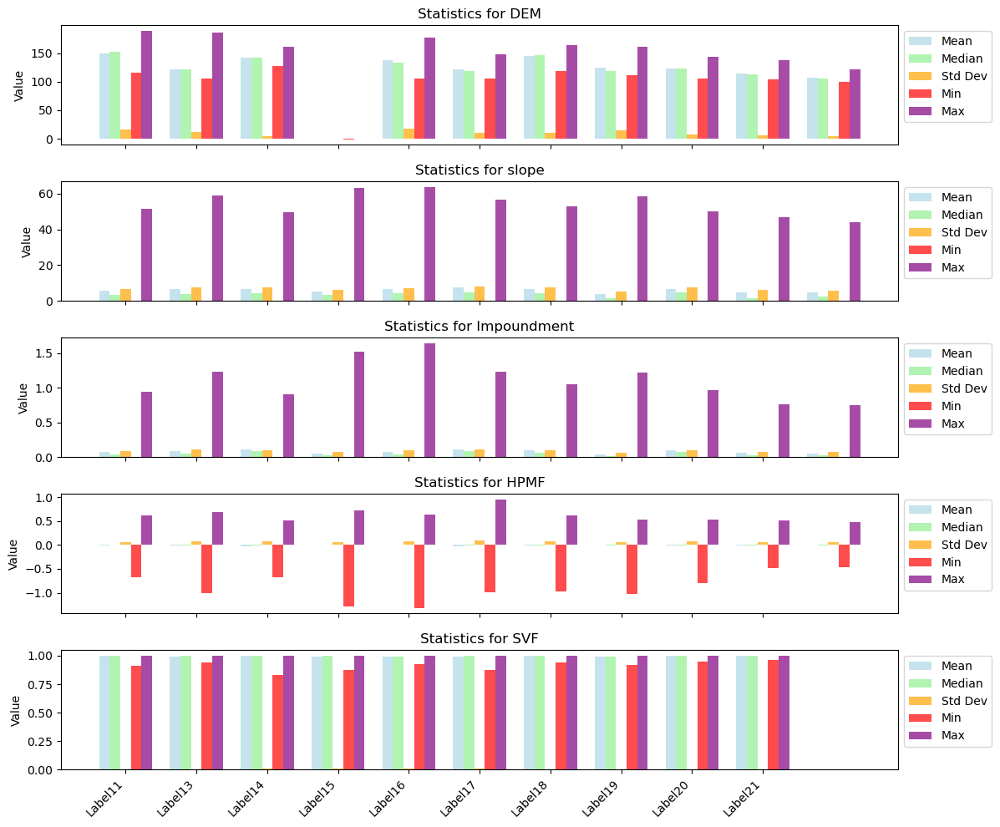

In [9]:
# Define the file paths for your datasets and labels
dataset_names = ['SVF', 'HPMF', 'Impoundment', 'DEM', 'slope']
file_path_template = '../../01_Data/01_Raw/features/features/{name}_{i}.npy'  # Template for each file

# Create an empty dictionary to store statistics
statistics = {
    'dataset': [],
    'label': [],
    'mean': [],
    'median': [],
    'std': [],
    'min': [],
    'max': []
}

# Iterate over files from 11 to 21 (matching the Label3m_{}.npy and dataset_{}.npy files)
for i in range(11, 22):  
    # Load the Label3m mask (binary mask)
    mask_file = f"../../01_Data/01_Raw/features/features/Label3m_{i}.npy"
    mask = np.load(mask_file)

    # Iterate over each dataset
    for dataset_name in dataset_names:
        dataset_file = file_path_template.format(name=dataset_name, i=i)
        data = np.load(dataset_file)

        # Apply the mask to extract the relevant values (where mask is True)
        masked_data = data[mask]

        # Filter out no-data values (-9999)
        valid_data = masked_data[masked_data != -99999]

        # Skip computation if there's no valid data
        if valid_data.size == 0:
            continue

        # Compute statistics for the valid data
        mean_val = np.mean(valid_data)
        median_val = np.median(valid_data)
        std_val = np.std(valid_data)
        min_val = np.min(valid_data)
        max_val = np.max(valid_data)

        # Store the statistics
        statistics['dataset'].append(dataset_name)
        statistics['label'].append(f"Label{i}")
        statistics['mean'].append(mean_val)
        statistics['median'].append(median_val)
        statistics['std'].append(std_val)
        statistics['min'].append(min_val)
        statistics['max'].append(max_val)

# Convert statistics to numpy arrays for easier handling
statistics = {key: np.array(value) for key, value in statistics.items()}

# Create a figure for plotting
fig, axes = plt.subplots(len(set(statistics['dataset'])), 1, figsize=(12, 10), sharex=True)
if len(set(statistics['dataset'])) == 1:  # Ensure axes is iterable even if there's only one dataset
    axes = [axes]

# Define color map
colors = {
    'mean': 'lightblue',
    'median': 'lightgreen',
    'std': 'orange',
    'min': 'red',
    'max': 'purple'
}

# Plotting each dataset's statistics
for ax, dataset in zip(axes, set(statistics['dataset'])):
    # Filter statistics by dataset
    dataset_mask = statistics['dataset'] == dataset
    dataset_stats = {key: statistics[key][dataset_mask] for key in statistics}

    # Set positions for bars (they will be grouped)
    positions = np.arange(len(dataset_stats['label']))

    # Plot each statistic as bars (with better colors and spacing)
    width = 0.15  # Width of the bars
    ax.bar(positions - width*2, dataset_stats['mean'], width=width, label='Mean', color=colors['mean'], alpha=0.7)
    ax.bar(positions - width, dataset_stats['median'], width=width, label='Median', color=colors['median'], alpha=0.7)
    ax.bar(positions, dataset_stats['std'], width=width, label='Std Dev', color=colors['std'], alpha=0.7)
    ax.bar(positions + width, dataset_stats['min'], width=width, label='Min', color=colors['min'], alpha=0.7)
    ax.bar(positions + width*2, dataset_stats['max'], width=width, label='Max', color=colors['max'], alpha=0.7)

    # Set labels, title, and legend
    ax.set_title(f"Statistics for {dataset}")
    ax.set_ylabel('Value')
    ax.set_xticks(positions)
    ax.set_xticklabels(dataset_stats['label'], rotation=45, ha='right')
    ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

# Adjust the layout and show the plot
plt.tight_layout()
plt.show()



## Viewing the Label3m positioning
The Label3m test, images are properly on top of each other and in same size.

Processing mask: Label3m_1.npy


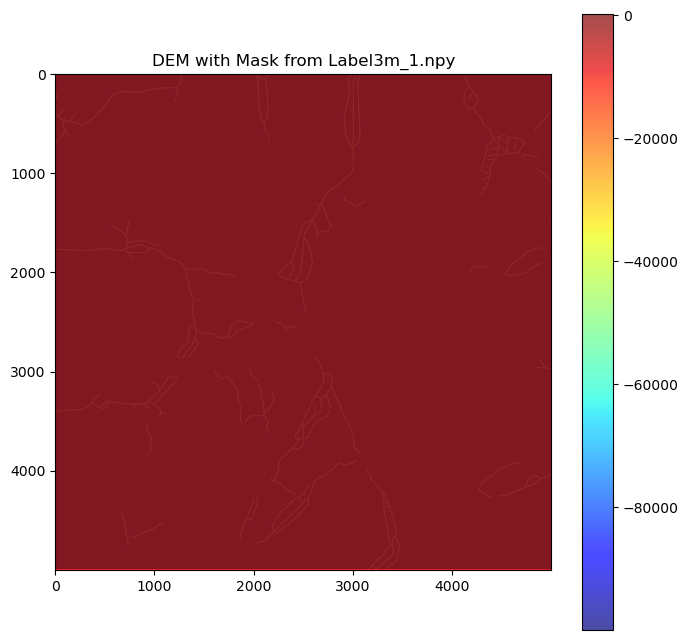

Accuracy for DEM with mask Label3m_1.npy: 0.0096


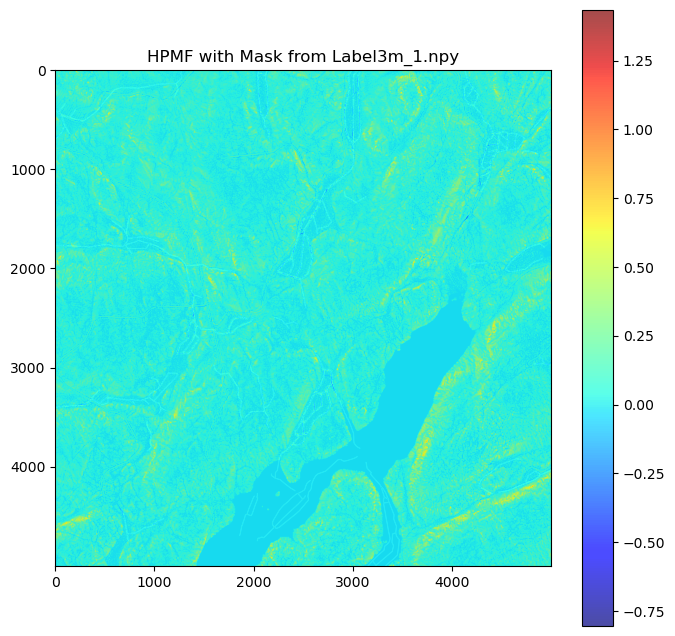

Accuracy for HPMF with mask Label3m_1.npy: 0.0130


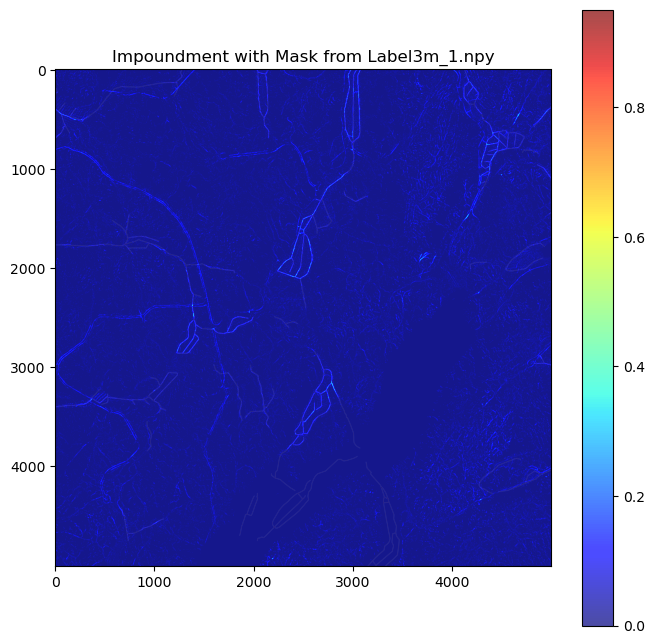

Accuracy for Impoundment with mask Label3m_1.npy: 0.5399


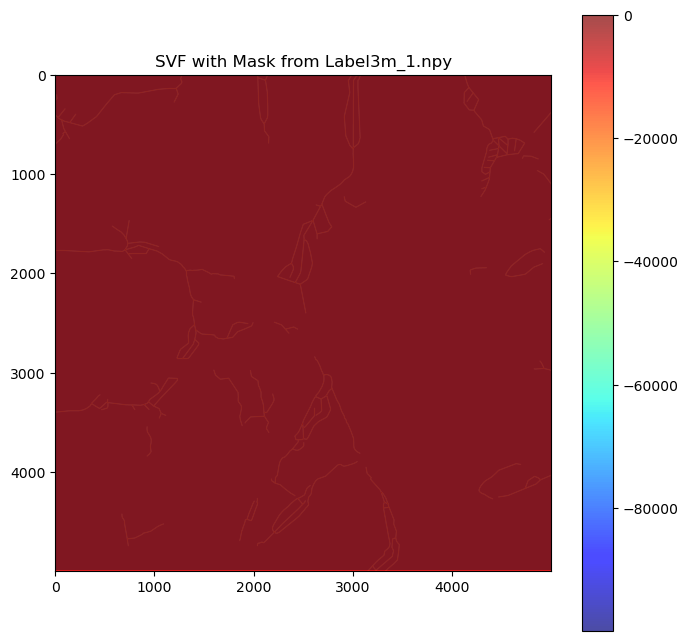

Accuracy for SVF with mask Label3m_1.npy: 0.0096


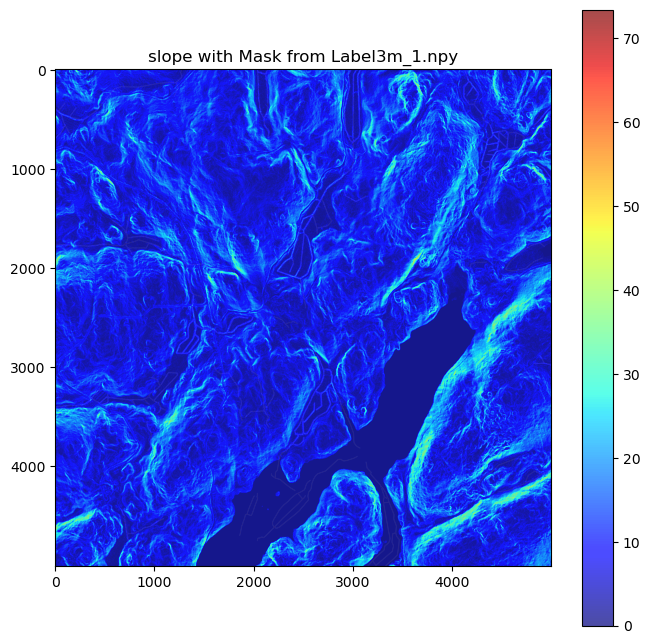

Accuracy for slope with mask Label3m_1.npy: 0.2969
Processing mask: Label3m_2.npy


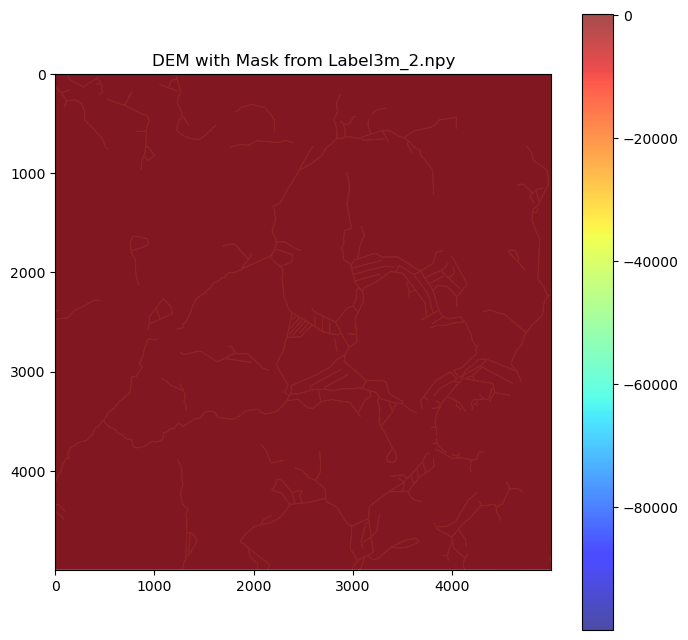

Accuracy for DEM with mask Label3m_2.npy: 0.0166


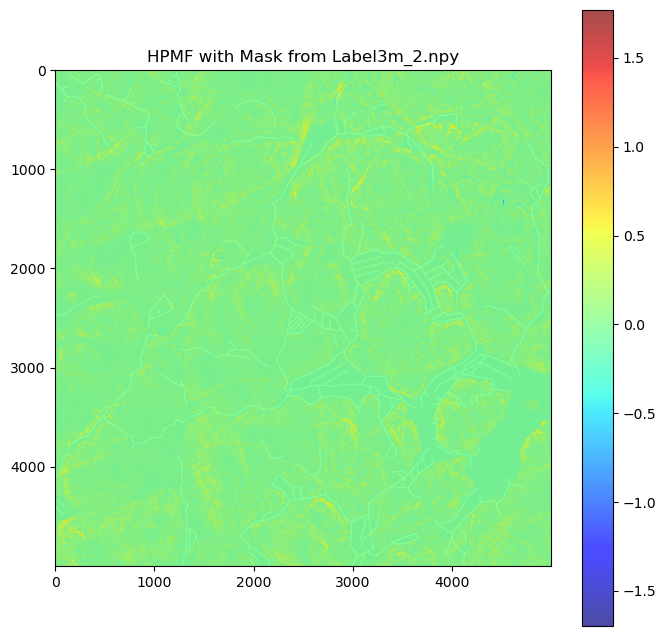

Accuracy for HPMF with mask Label3m_2.npy: 0.0205


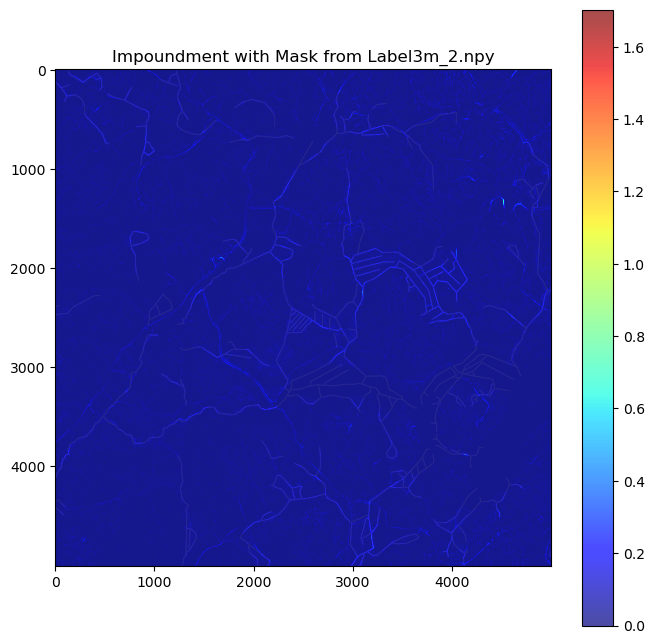

Accuracy for Impoundment with mask Label3m_2.npy: 0.4641


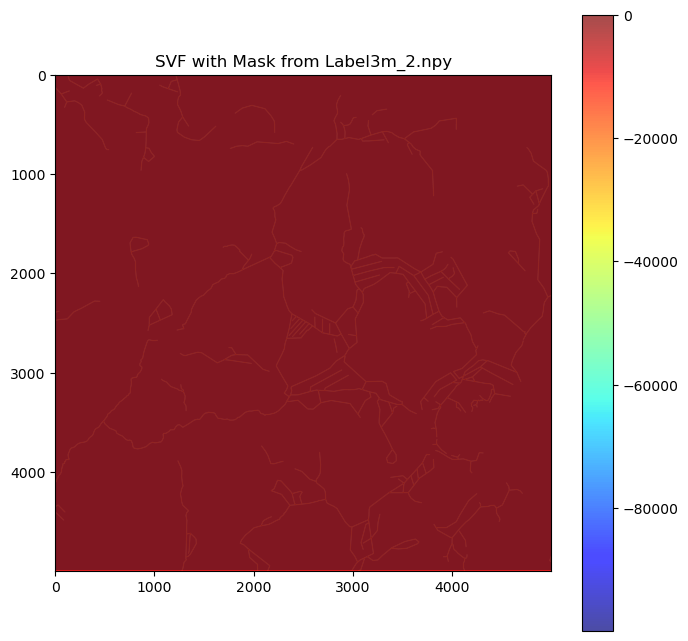

Accuracy for SVF with mask Label3m_2.npy: 0.0166


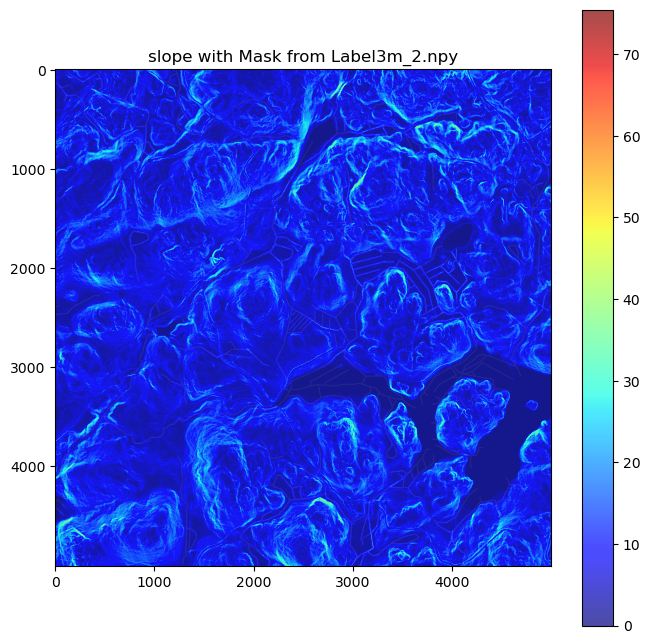

Accuracy for slope with mask Label3m_2.npy: 0.2858
Processing mask: Label3m_3.npy


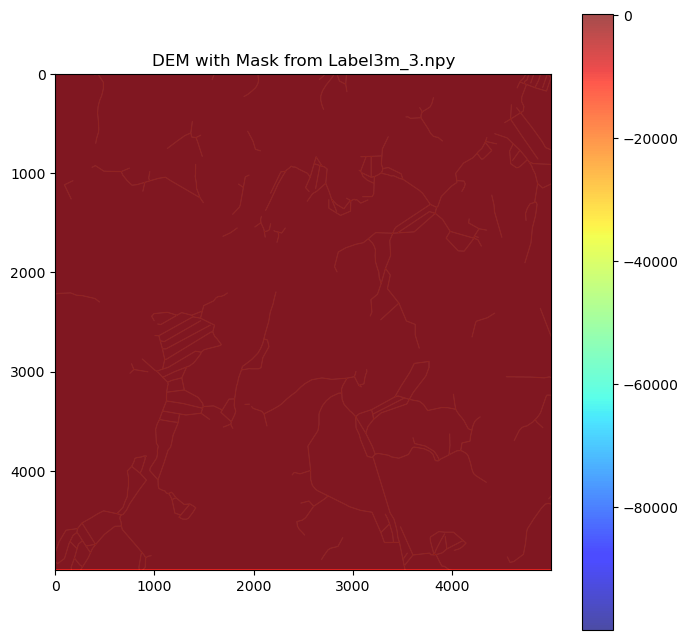

Accuracy for DEM with mask Label3m_3.npy: 0.0159


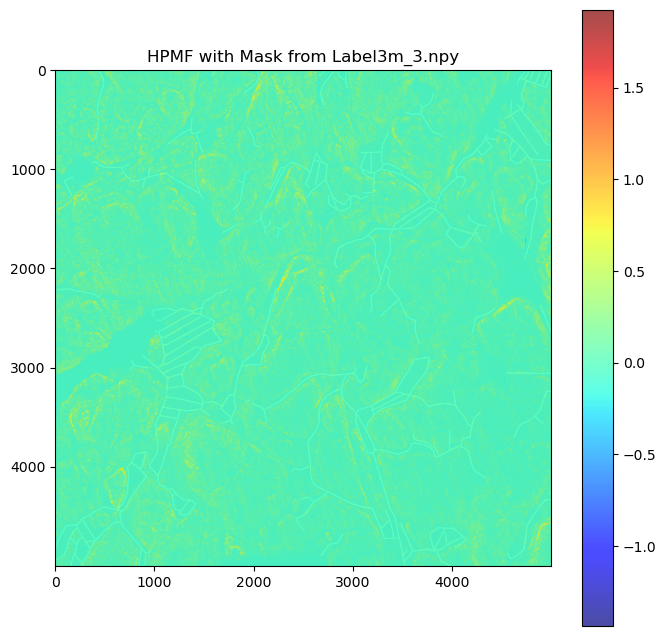

Accuracy for HPMF with mask Label3m_3.npy: 0.0188


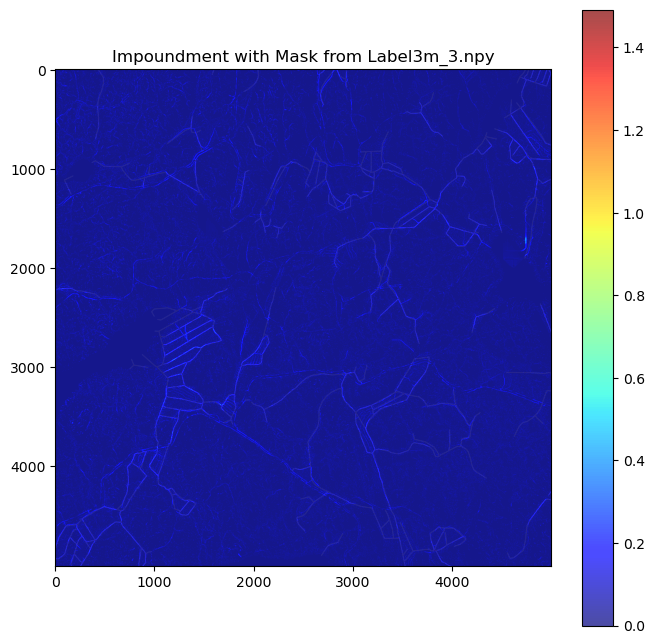

Accuracy for Impoundment with mask Label3m_3.npy: 0.4172


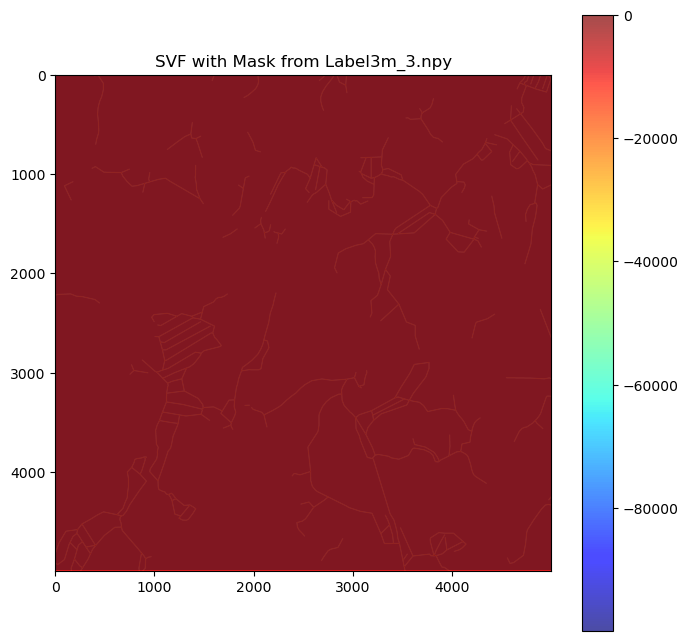

Accuracy for SVF with mask Label3m_3.npy: 0.0159


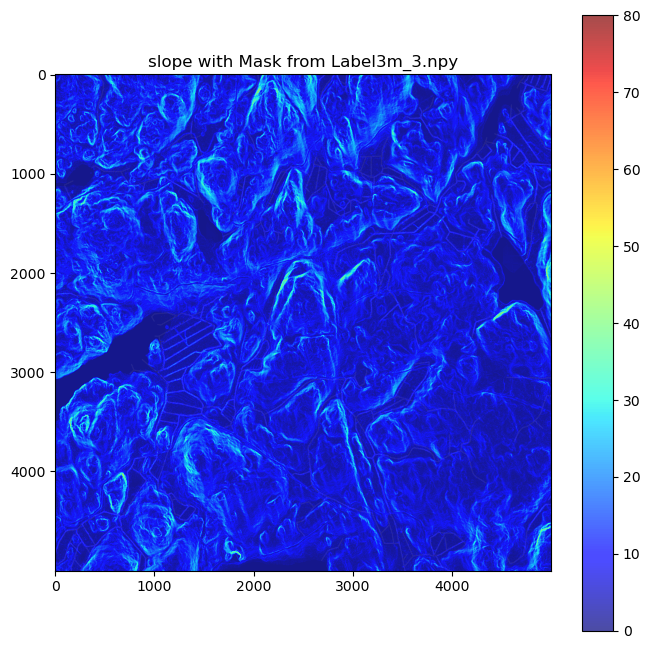

Accuracy for slope with mask Label3m_3.npy: 0.2748
Processing mask: Label3m_4.npy


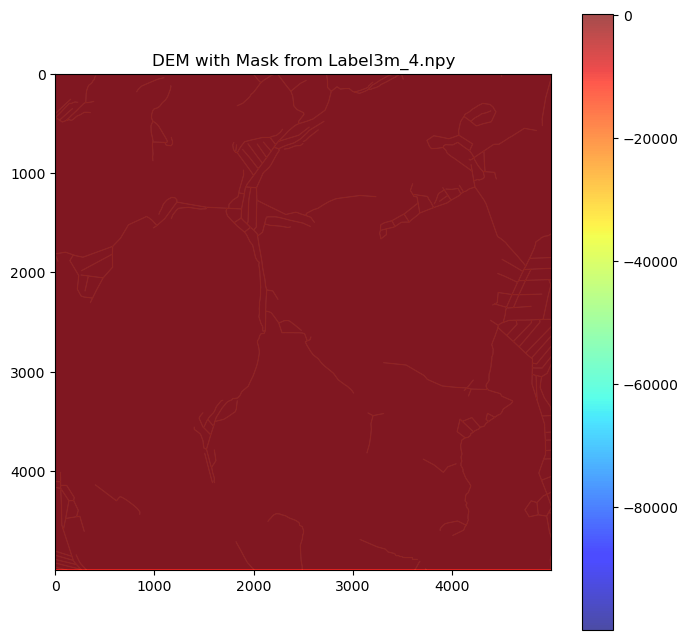

Accuracy for DEM with mask Label3m_4.npy: 0.0148


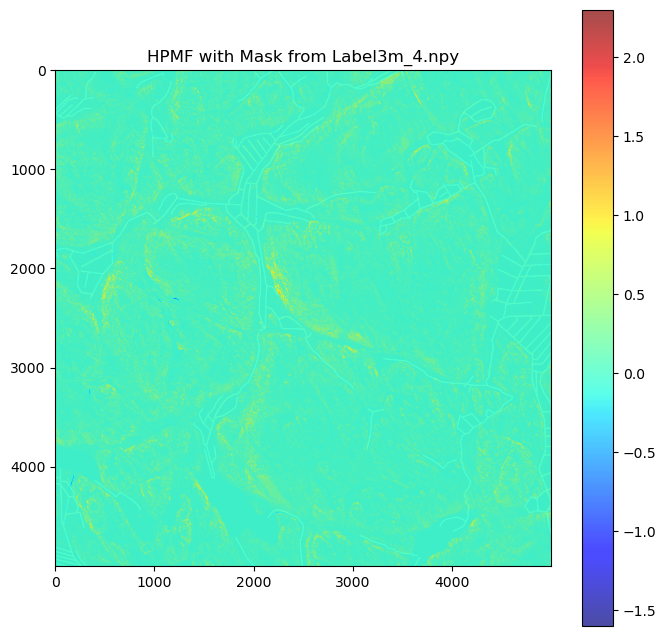

Accuracy for HPMF with mask Label3m_4.npy: 0.0192


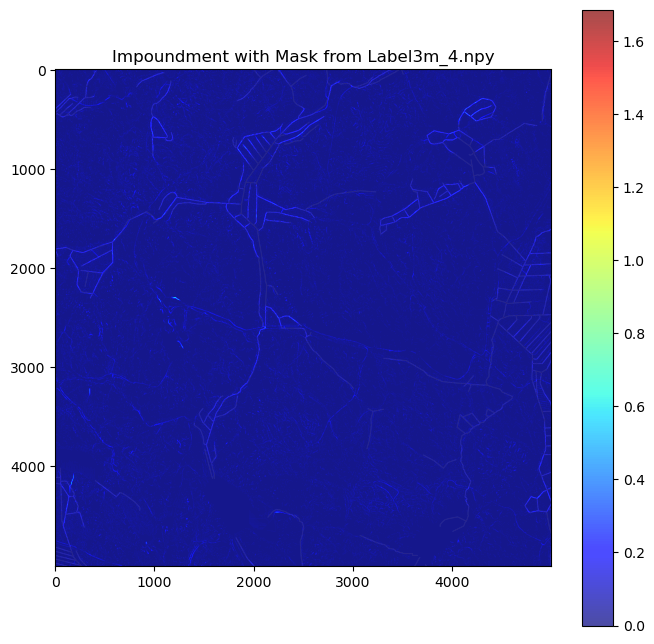

Accuracy for Impoundment with mask Label3m_4.npy: 0.4690


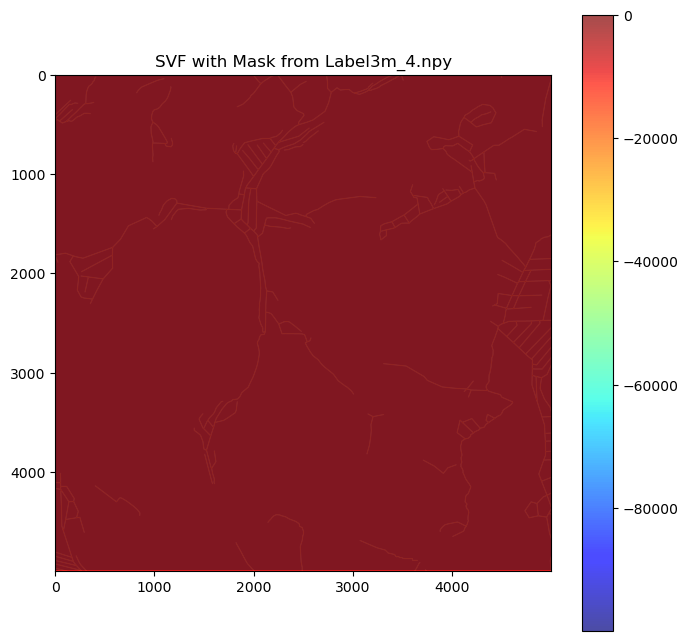

Accuracy for SVF with mask Label3m_4.npy: 0.0148


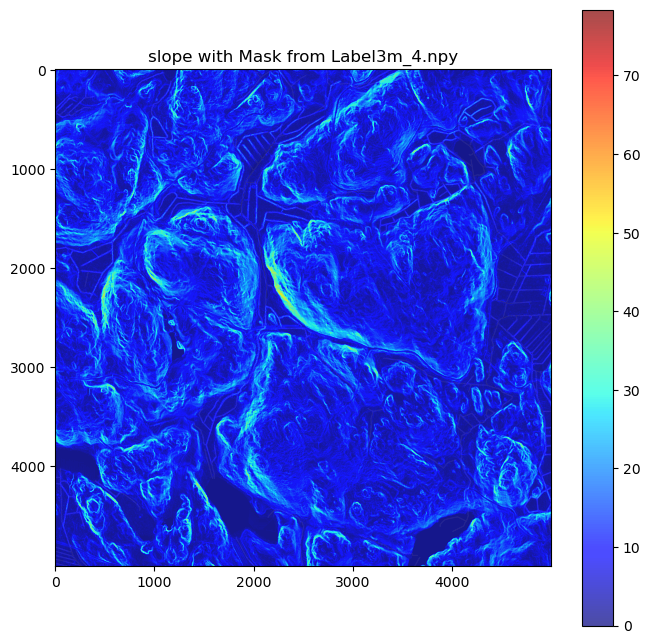

Accuracy for slope with mask Label3m_4.npy: 0.2670
Processing mask: Label3m_5.npy


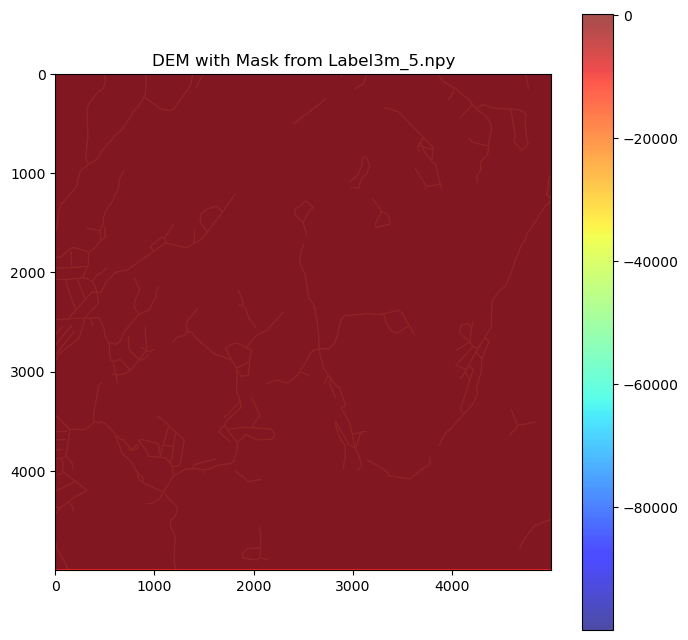

Accuracy for DEM with mask Label3m_5.npy: 0.0132


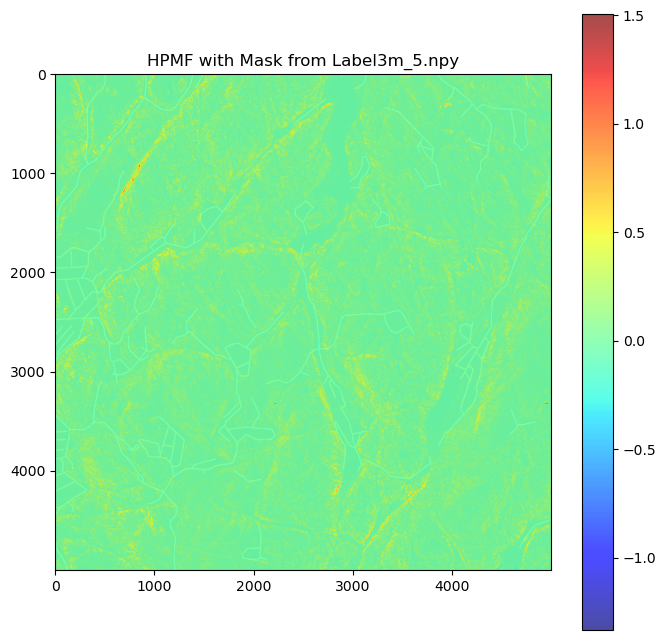

Accuracy for HPMF with mask Label3m_5.npy: 0.0178


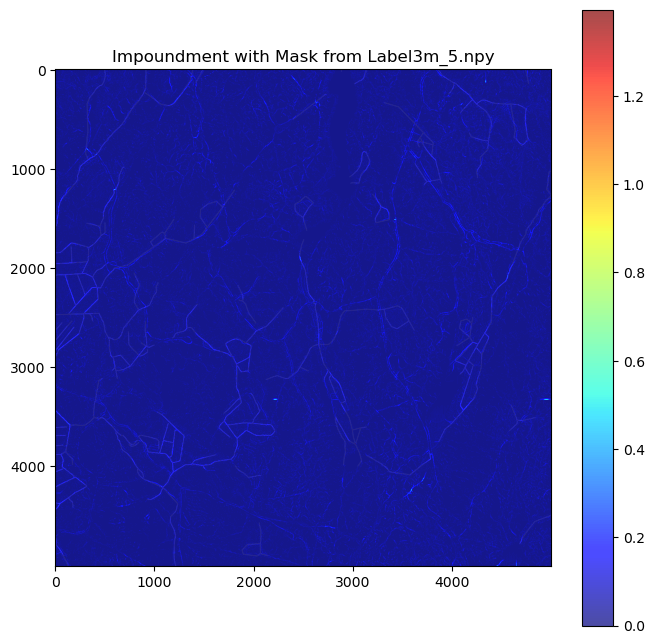

Accuracy for Impoundment with mask Label3m_5.npy: 0.4508


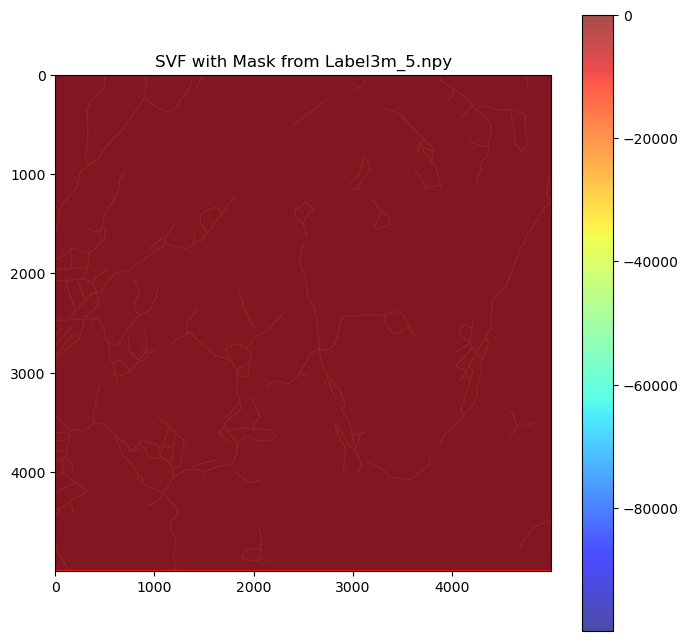

Accuracy for SVF with mask Label3m_5.npy: 0.0132


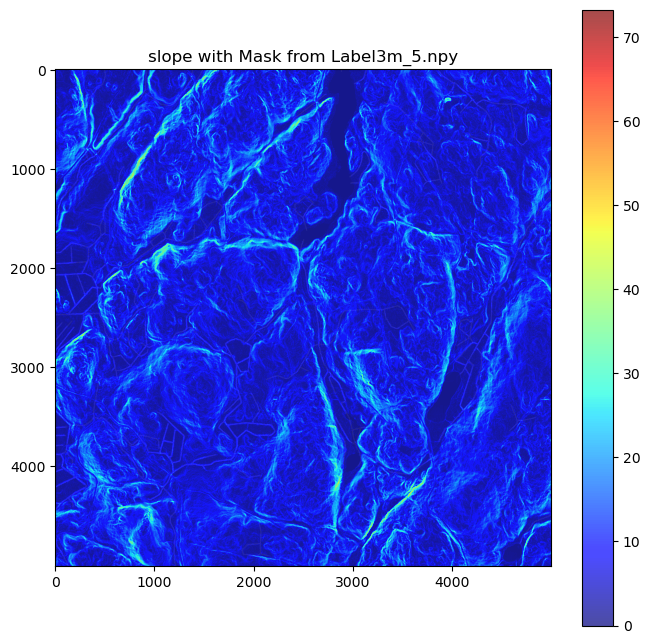

Accuracy for slope with mask Label3m_5.npy: 0.2647
Processing mask: Label3m_6.npy


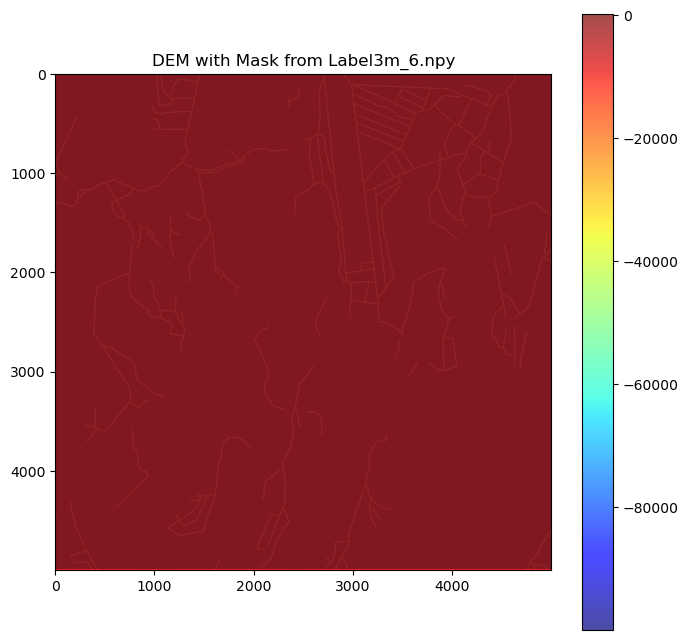

Accuracy for DEM with mask Label3m_6.npy: 0.0172


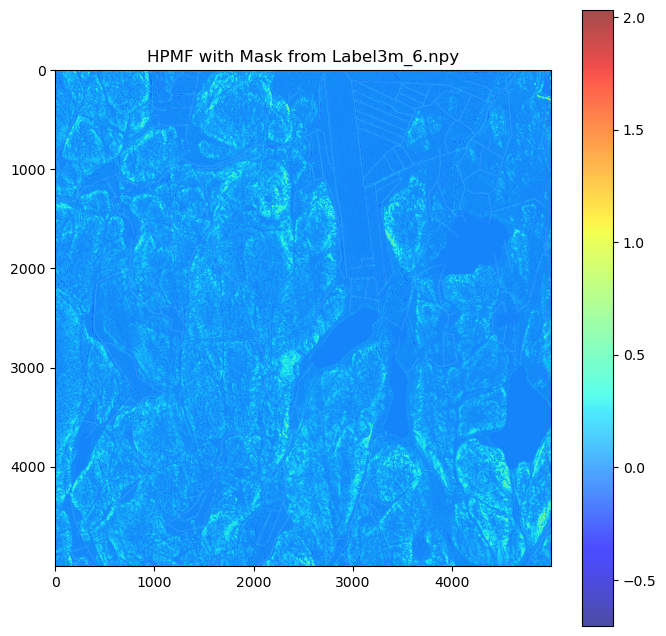

Accuracy for HPMF with mask Label3m_6.npy: 0.0202


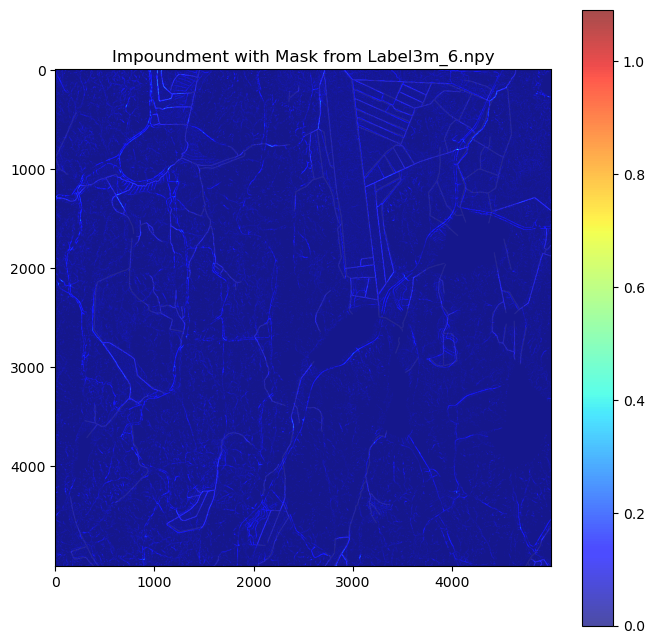

Accuracy for Impoundment with mask Label3m_6.npy: 0.4470


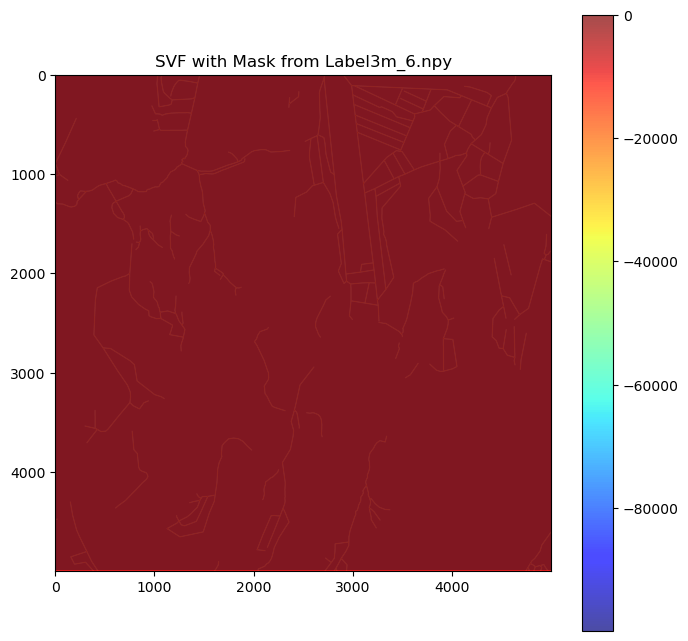

Accuracy for SVF with mask Label3m_6.npy: 0.0172


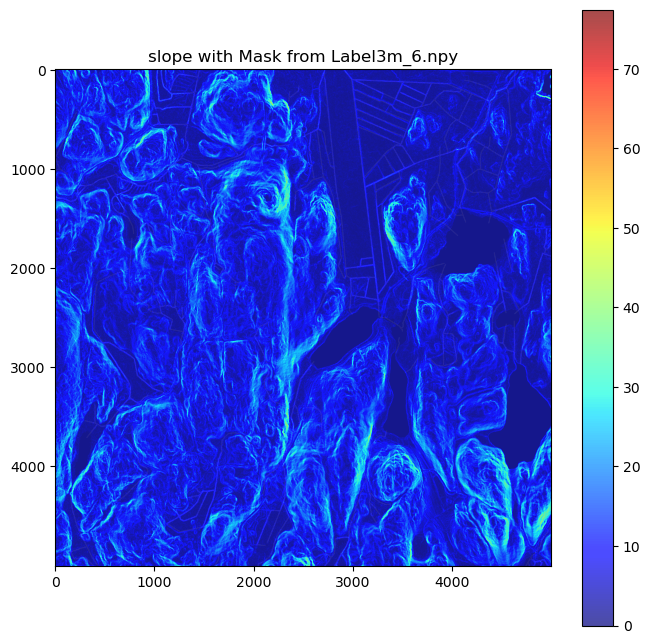

Accuracy for slope with mask Label3m_6.npy: 0.2845
Processing mask: Label3m_7.npy


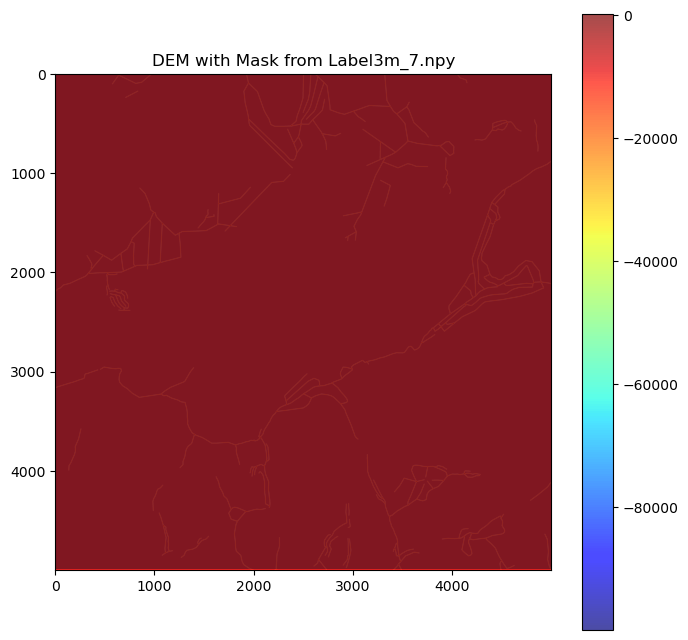

Accuracy for DEM with mask Label3m_7.npy: 0.0142


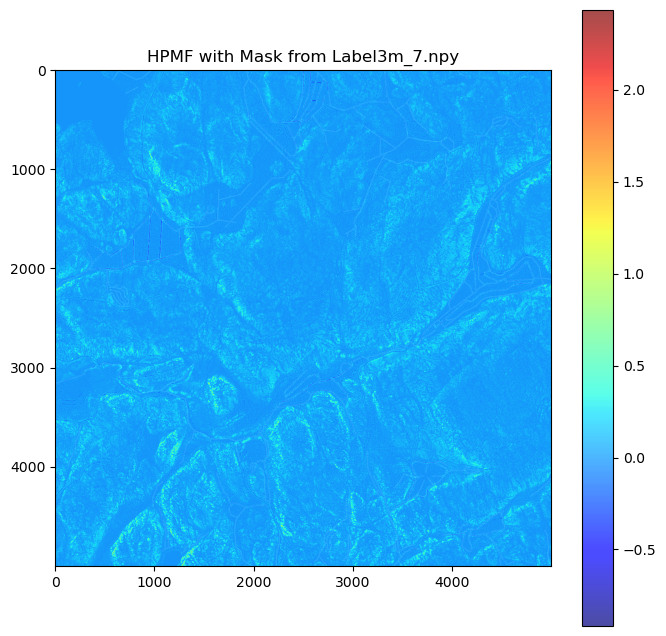

Accuracy for HPMF with mask Label3m_7.npy: 0.0177


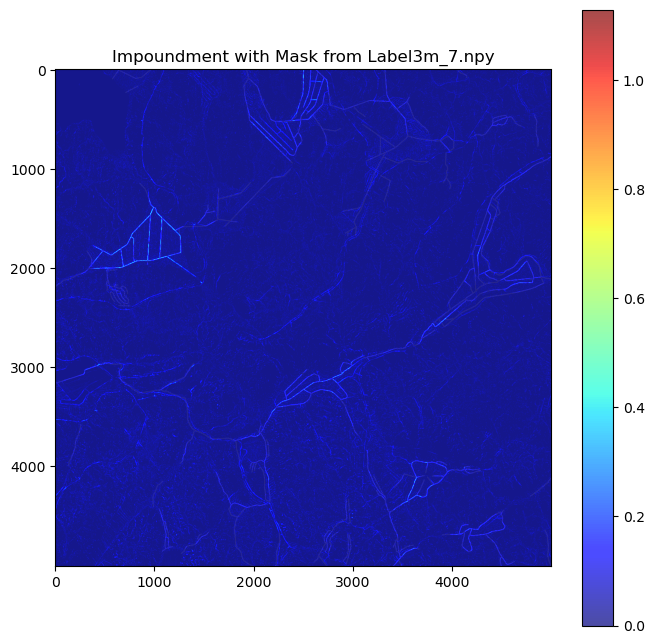

Accuracy for Impoundment with mask Label3m_7.npy: 0.4301


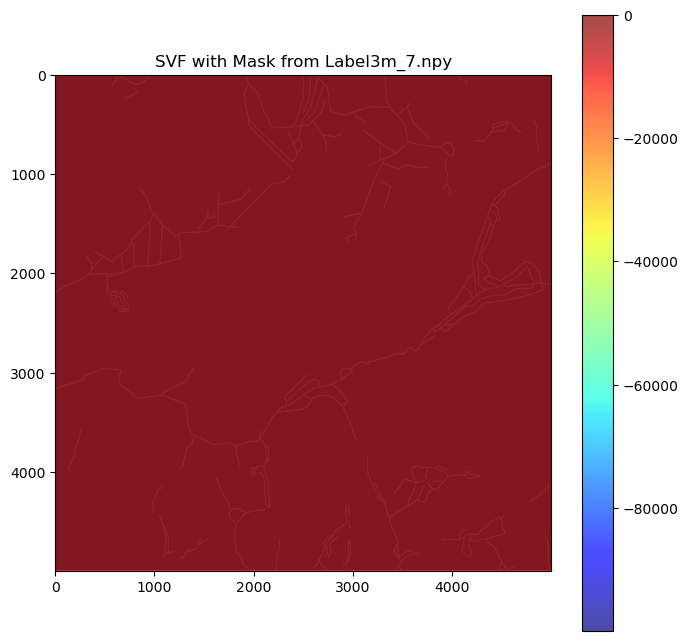

Accuracy for SVF with mask Label3m_7.npy: 0.0142


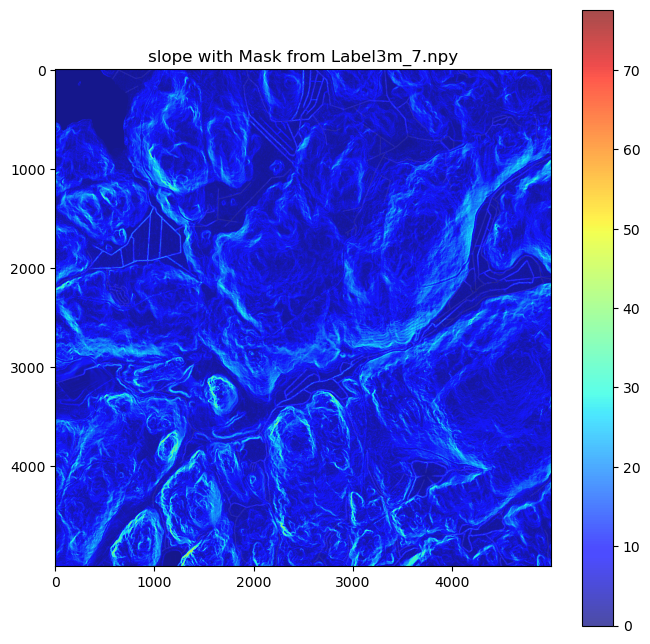

Accuracy for slope with mask Label3m_7.npy: 0.2679
Processing mask: Label3m_8.npy


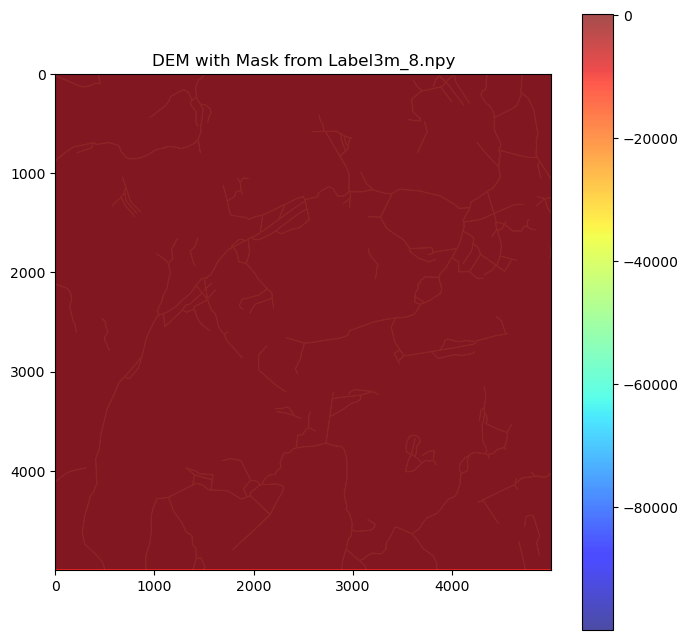

Accuracy for DEM with mask Label3m_8.npy: 0.0156


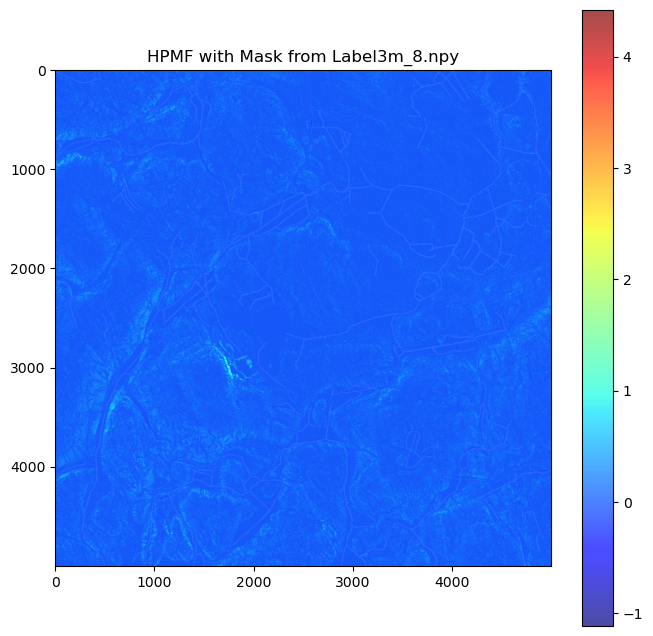

Accuracy for HPMF with mask Label3m_8.npy: 0.0183


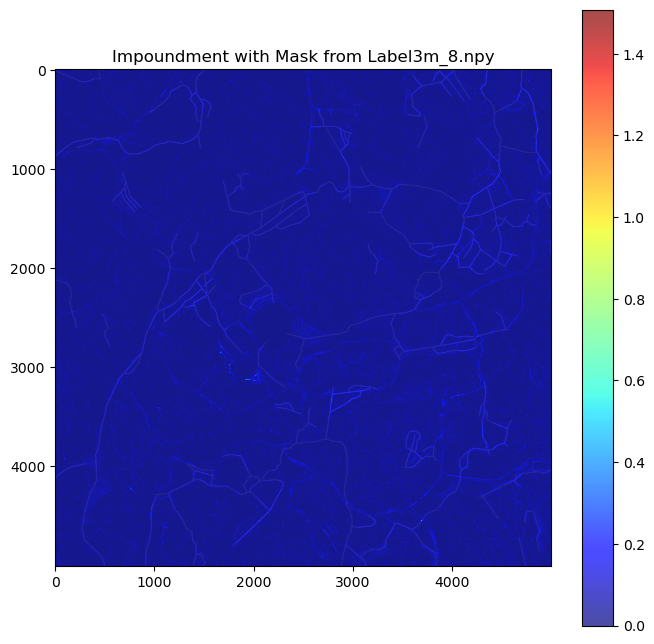

Accuracy for Impoundment with mask Label3m_8.npy: 0.3771


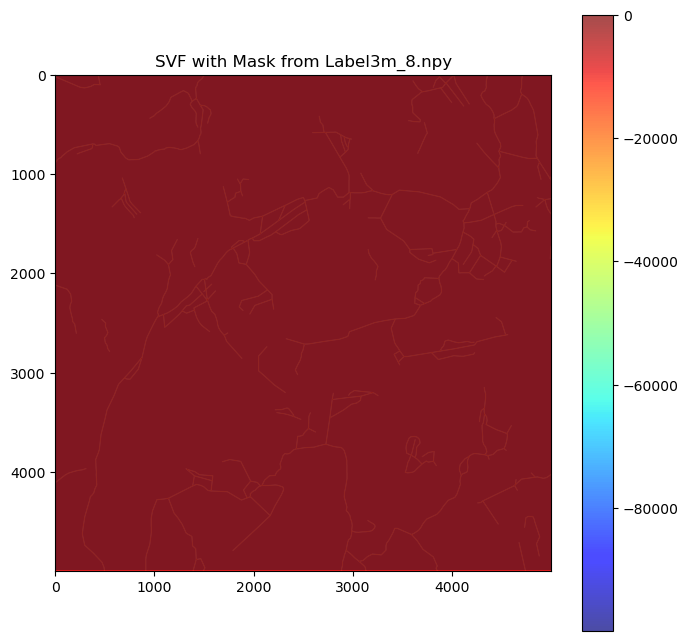

Accuracy for SVF with mask Label3m_8.npy: 0.0156


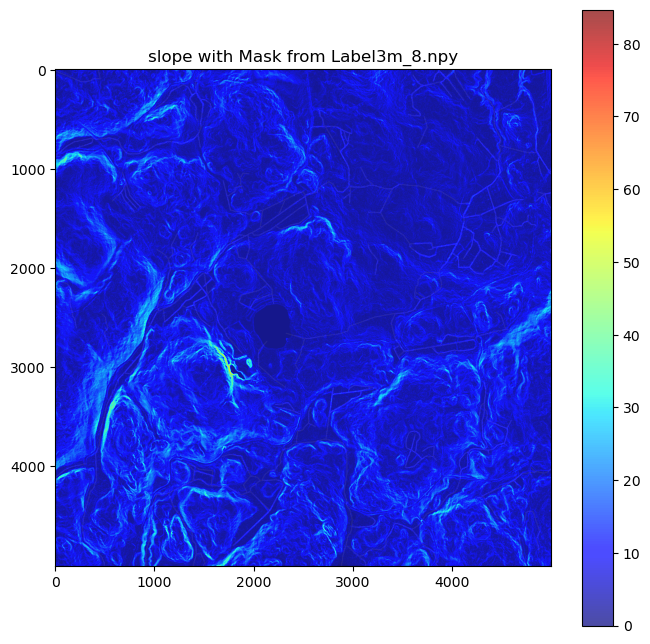

Accuracy for slope with mask Label3m_8.npy: 0.2621
Processing mask: Label3m_9.npy


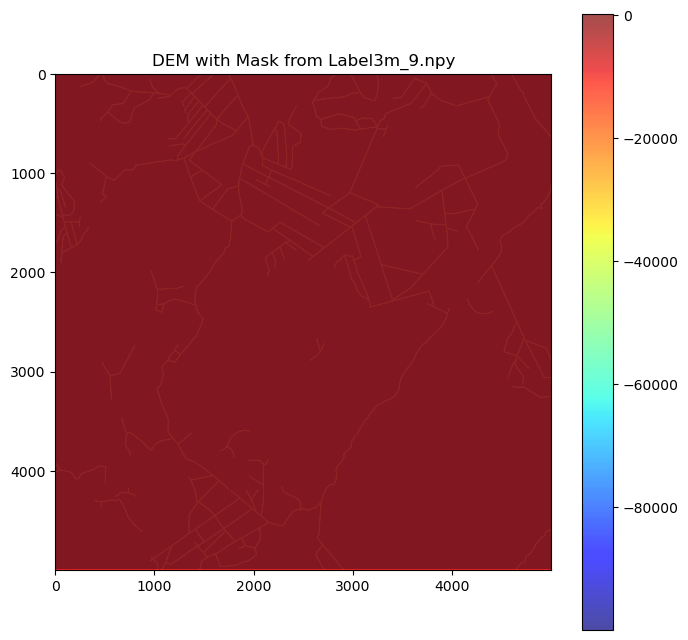

Accuracy for DEM with mask Label3m_9.npy: 0.0173


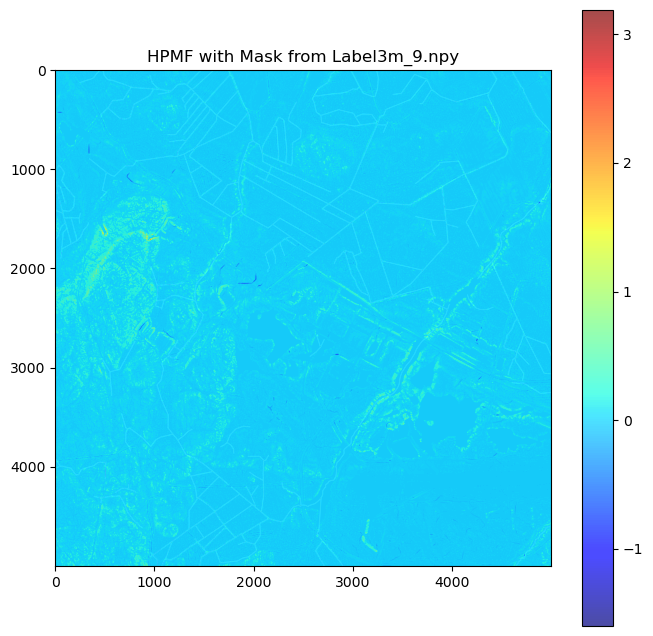

Accuracy for HPMF with mask Label3m_9.npy: 0.0214


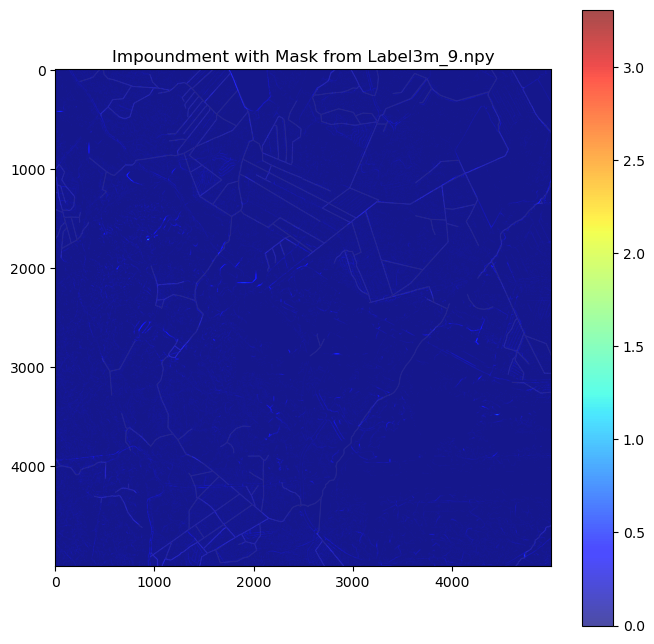

Accuracy for Impoundment with mask Label3m_9.npy: 0.3223


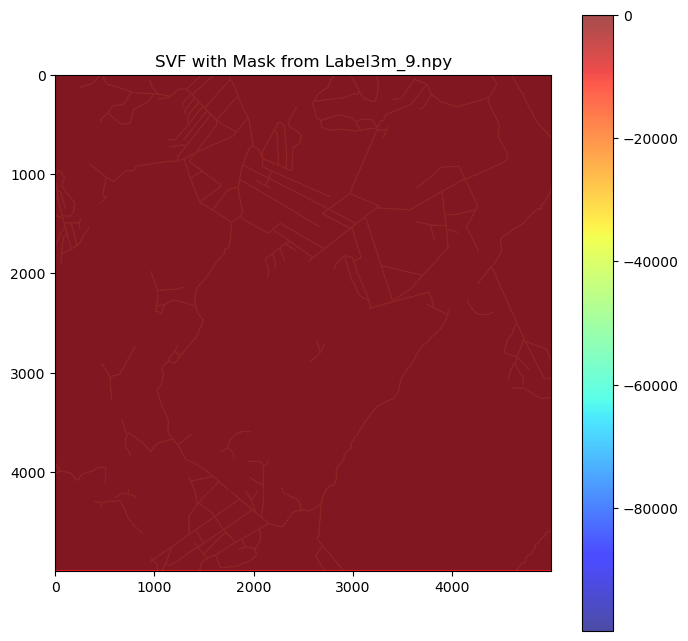

Accuracy for SVF with mask Label3m_9.npy: 0.0173


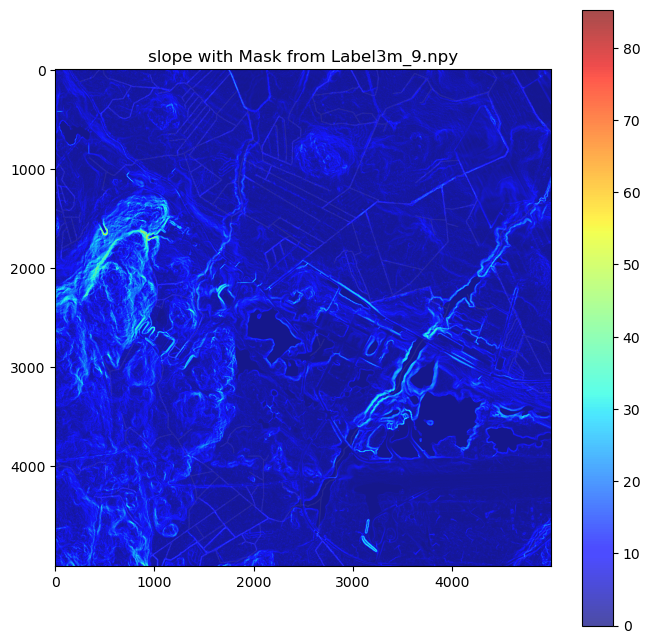

Accuracy for slope with mask Label3m_9.npy: 0.2848
Processing mask: Label3m_10.npy


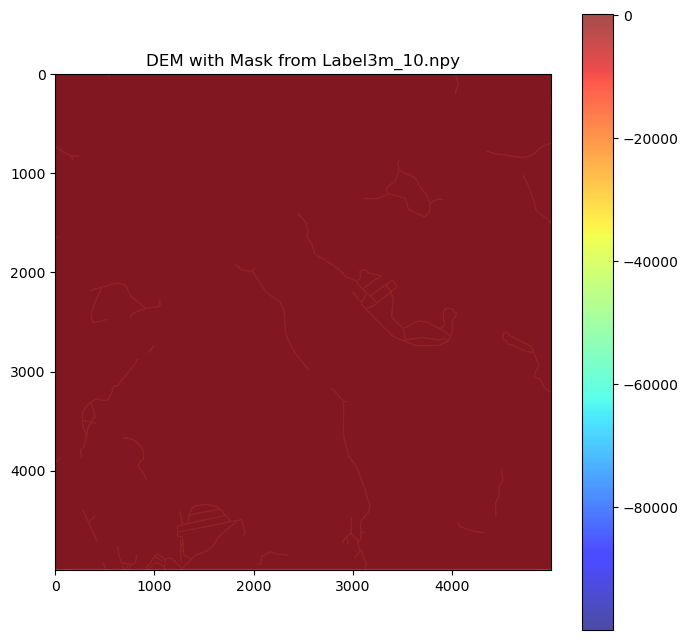

Accuracy for DEM with mask Label3m_10.npy: 0.0064


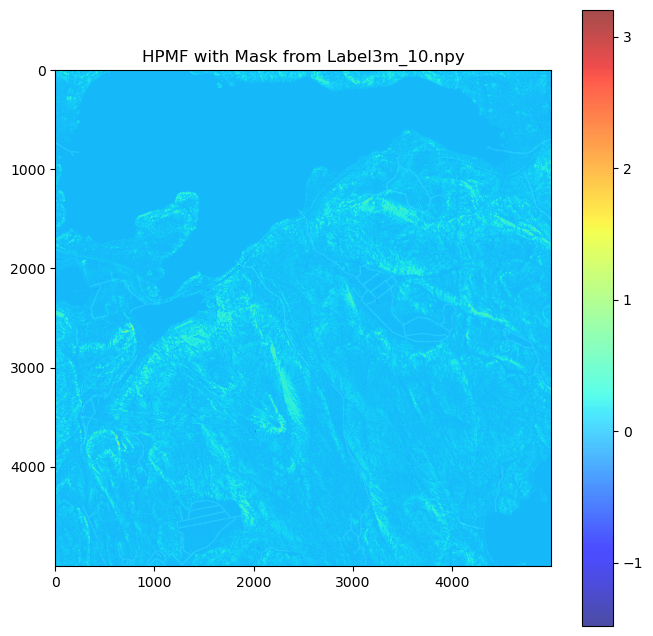

Accuracy for HPMF with mask Label3m_10.npy: 0.0590


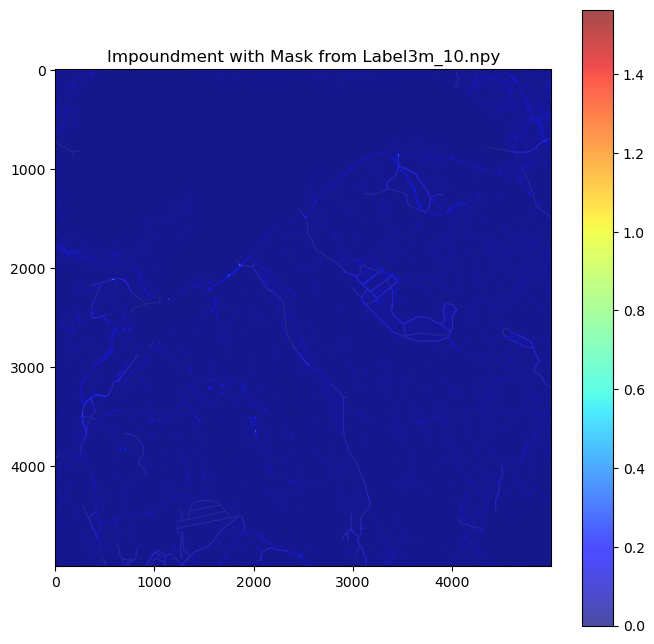

Accuracy for Impoundment with mask Label3m_10.npy: 0.5198


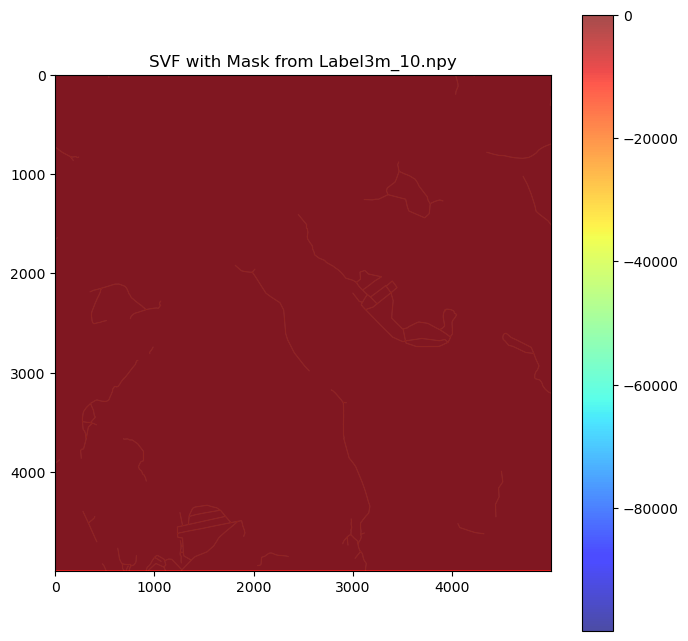

Accuracy for SVF with mask Label3m_10.npy: 0.0064


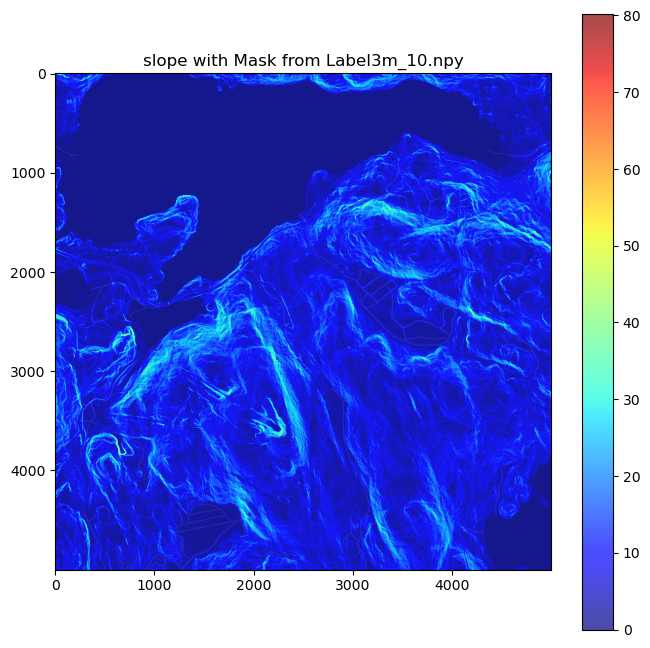

Accuracy for slope with mask Label3m_10.npy: 0.3617
Processing mask: Label3m_11.npy


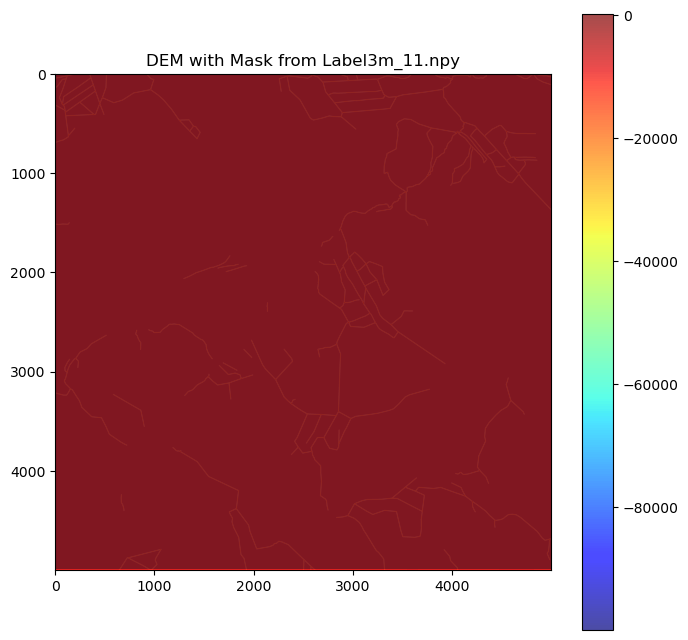

Accuracy for DEM with mask Label3m_11.npy: 0.0133


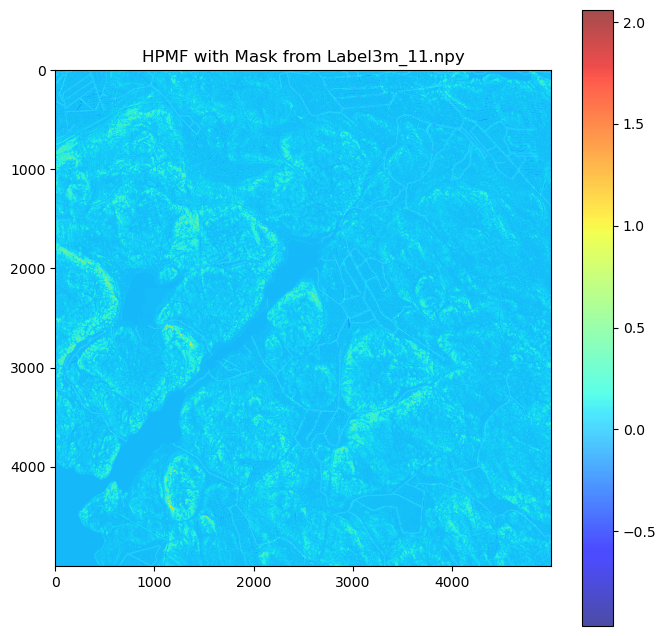

Accuracy for HPMF with mask Label3m_11.npy: 0.0178


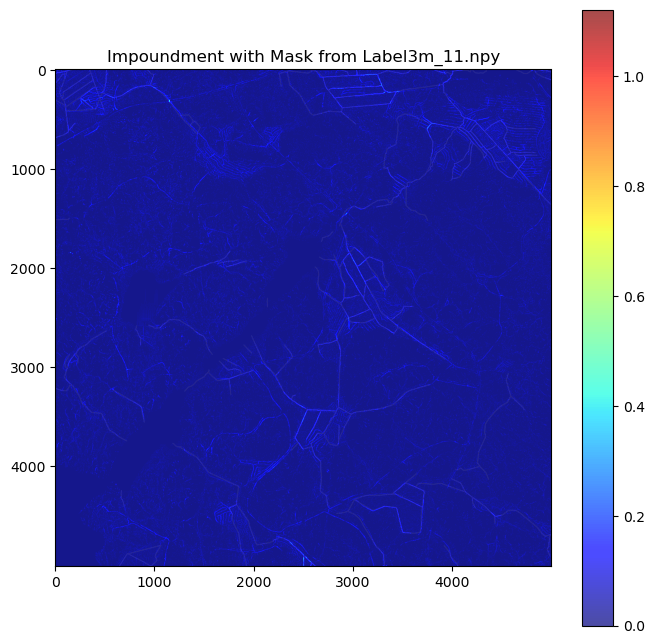

Accuracy for Impoundment with mask Label3m_11.npy: 0.4217


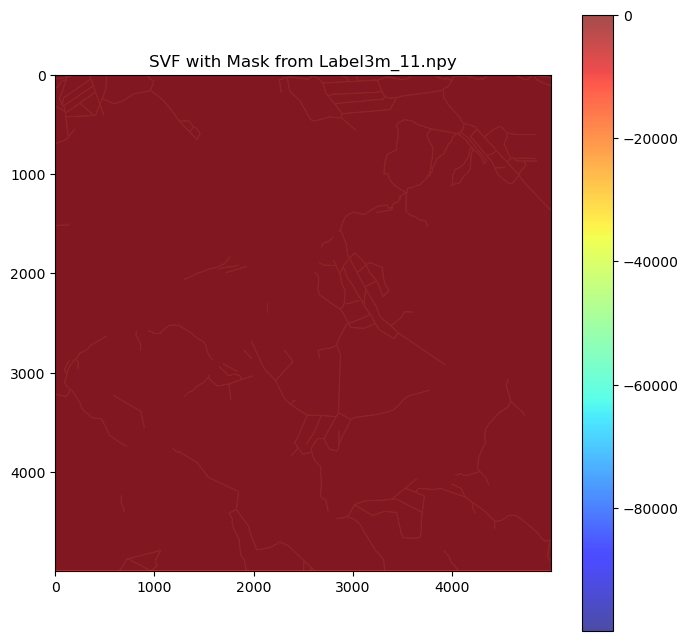

Accuracy for SVF with mask Label3m_11.npy: 0.0133


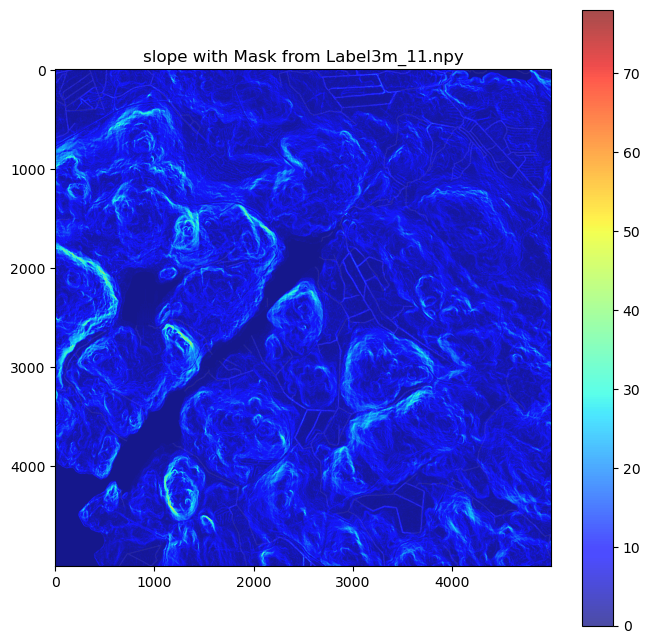

Accuracy for slope with mask Label3m_11.npy: 0.2828
Processing mask: Label3m_12.npy


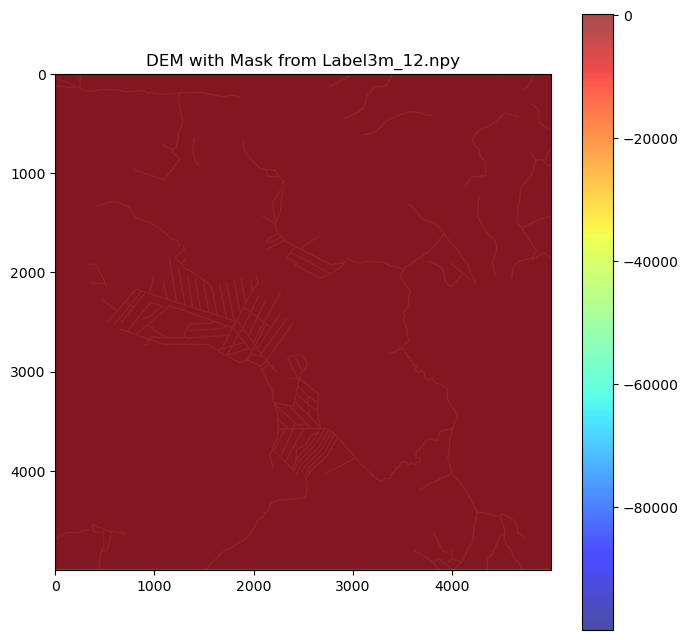

Accuracy for DEM with mask Label3m_12.npy: 0.0149


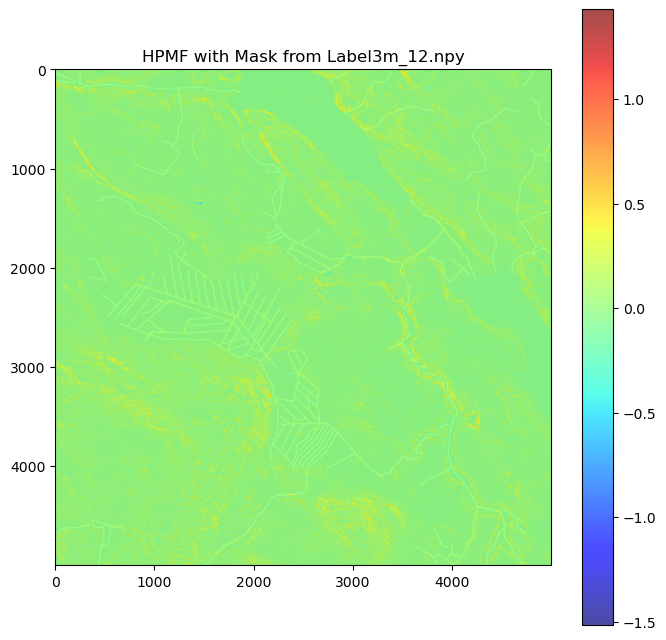

Accuracy for HPMF with mask Label3m_12.npy: 0.0200


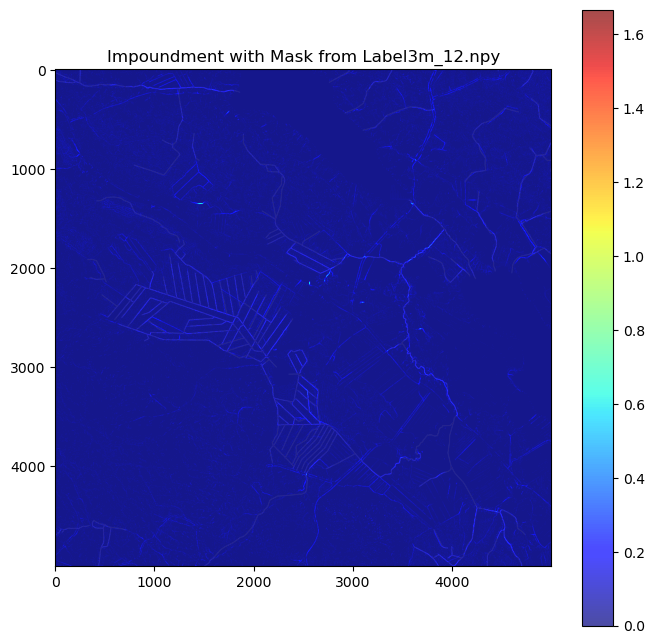

Accuracy for Impoundment with mask Label3m_12.npy: 0.4314


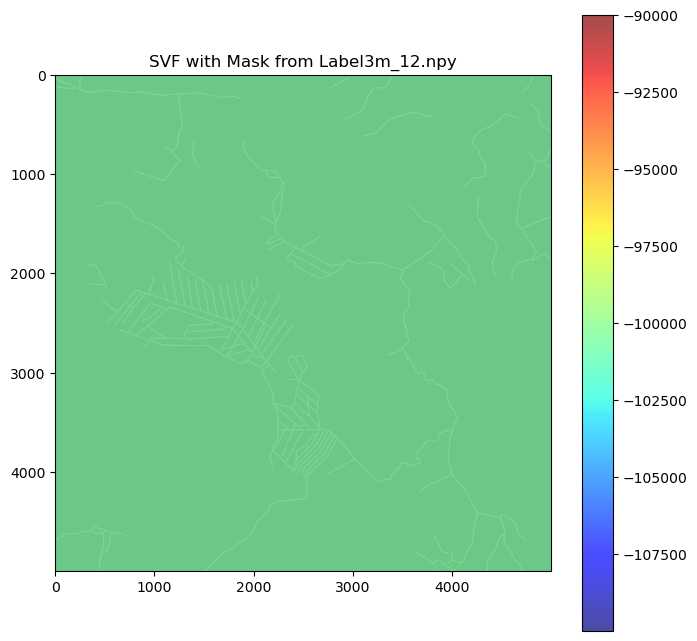

Accuracy for SVF with mask Label3m_12.npy: 0.0149


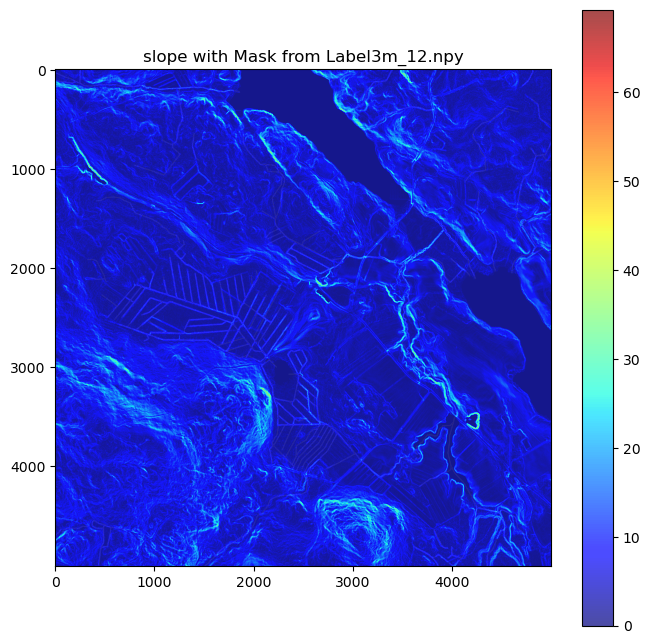

Accuracy for slope with mask Label3m_12.npy: 0.2868
Processing mask: Label3m_13.npy


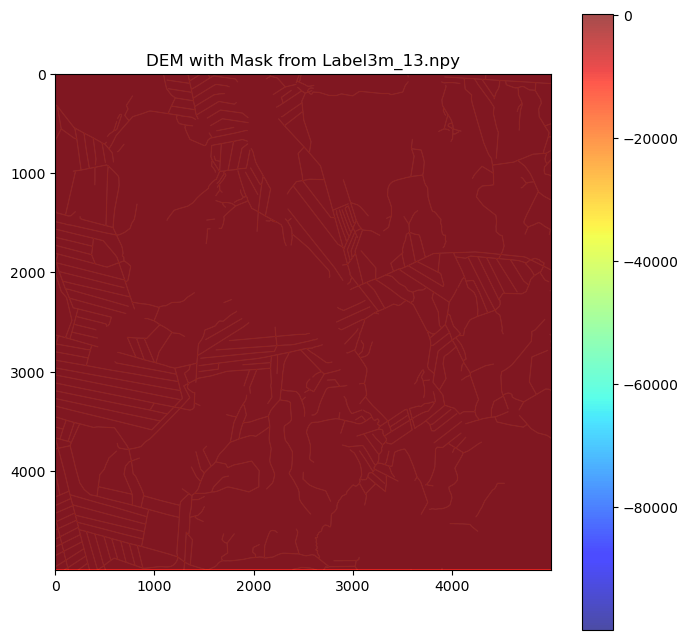

Accuracy for DEM with mask Label3m_13.npy: 0.0386


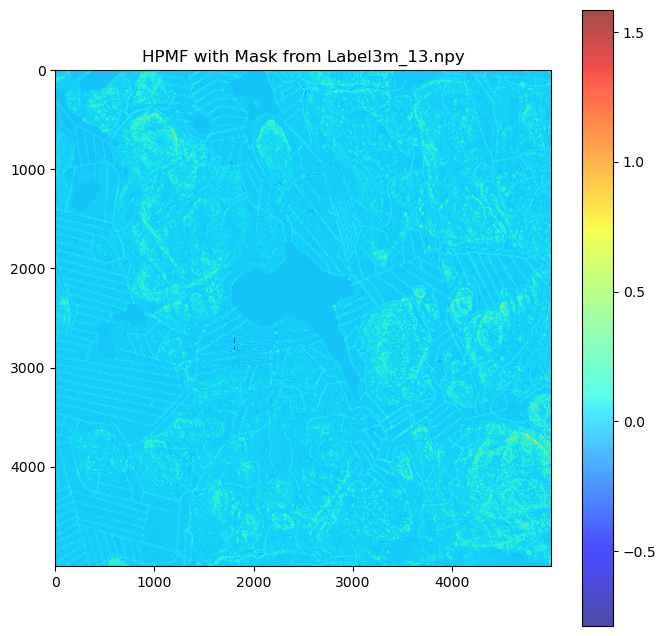

Accuracy for HPMF with mask Label3m_13.npy: 0.0420


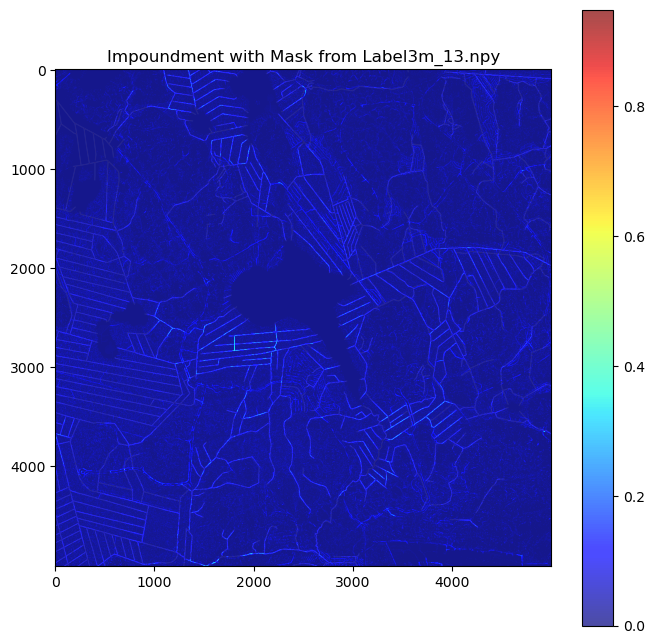

Accuracy for Impoundment with mask Label3m_13.npy: 0.2953


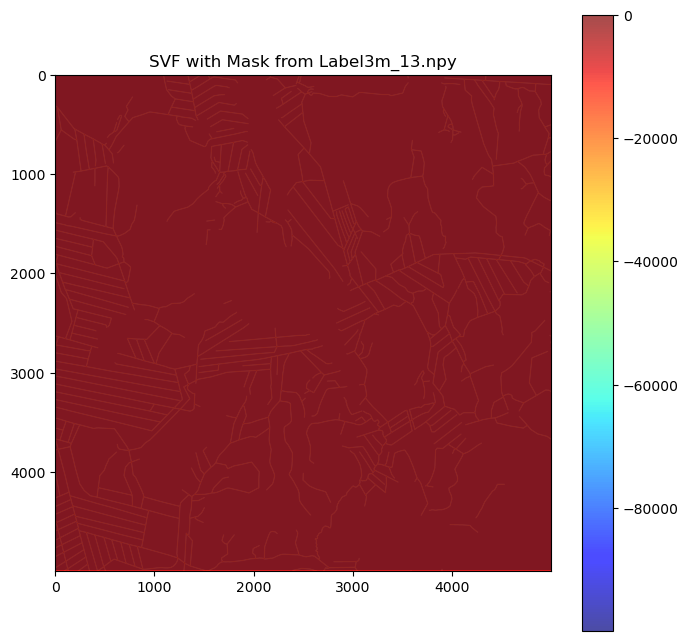

Accuracy for SVF with mask Label3m_13.npy: 0.0386


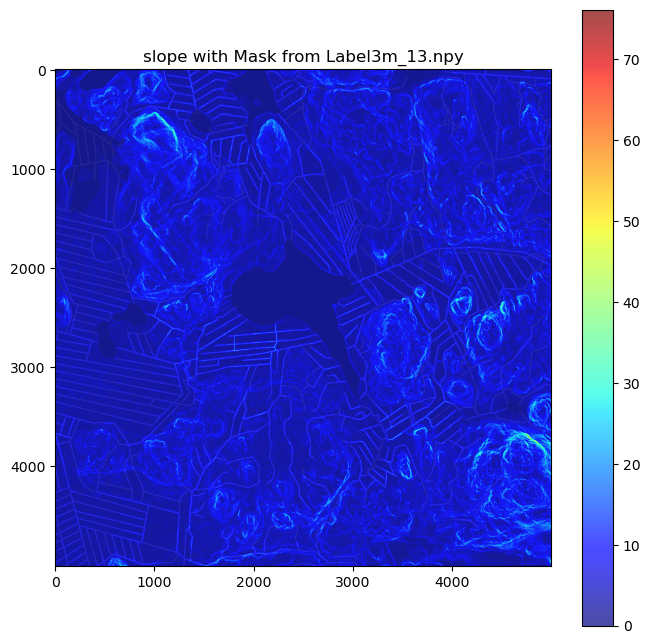

Accuracy for slope with mask Label3m_13.npy: 0.3005
Processing mask: Label3m_14.npy


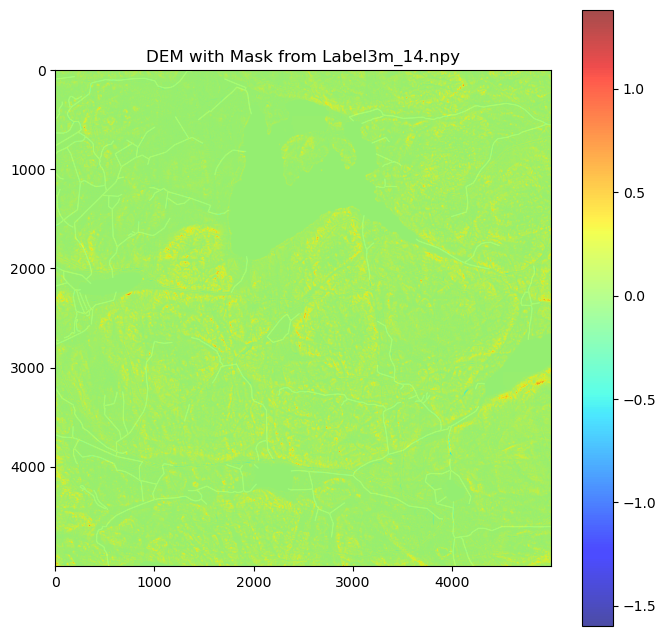

Accuracy for DEM with mask Label3m_14.npy: 0.0193


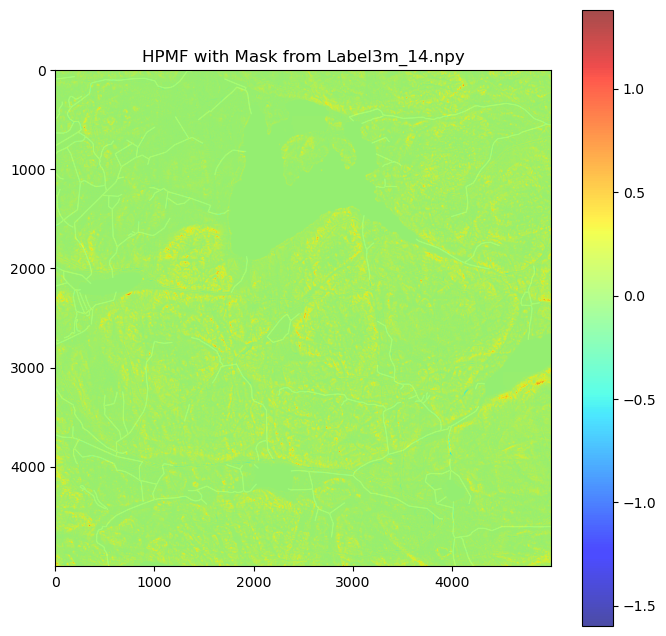

Accuracy for HPMF with mask Label3m_14.npy: 0.0193


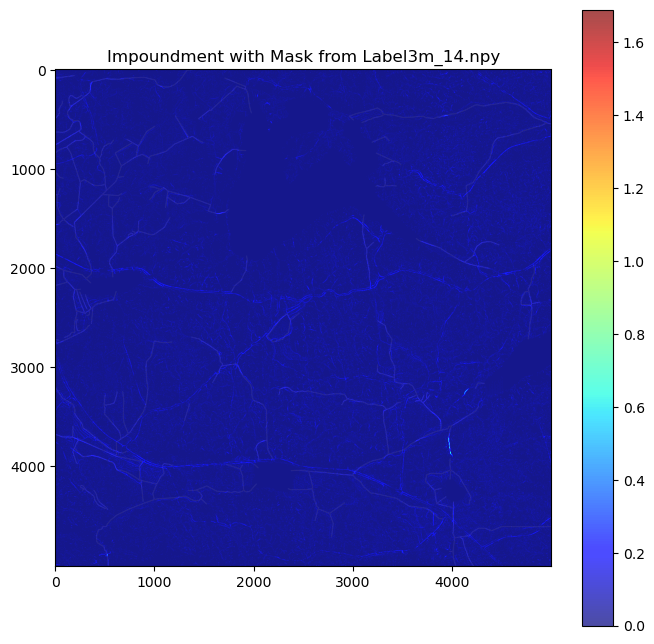

Accuracy for Impoundment with mask Label3m_14.npy: 0.3710


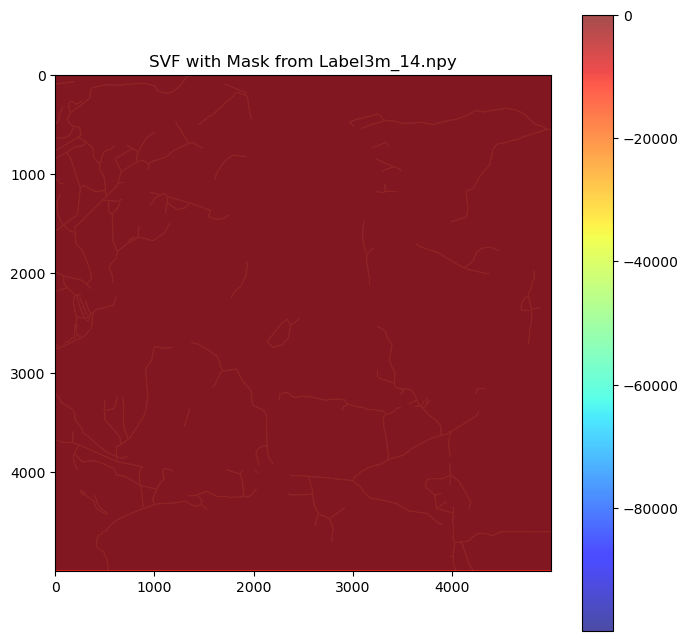

Accuracy for SVF with mask Label3m_14.npy: 0.0127


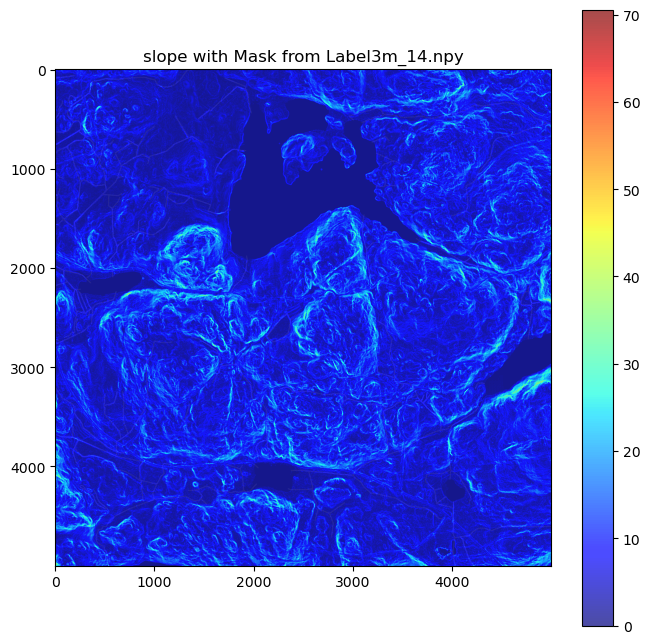

Accuracy for slope with mask Label3m_14.npy: 0.2962
Processing mask: Label3m_15.npy


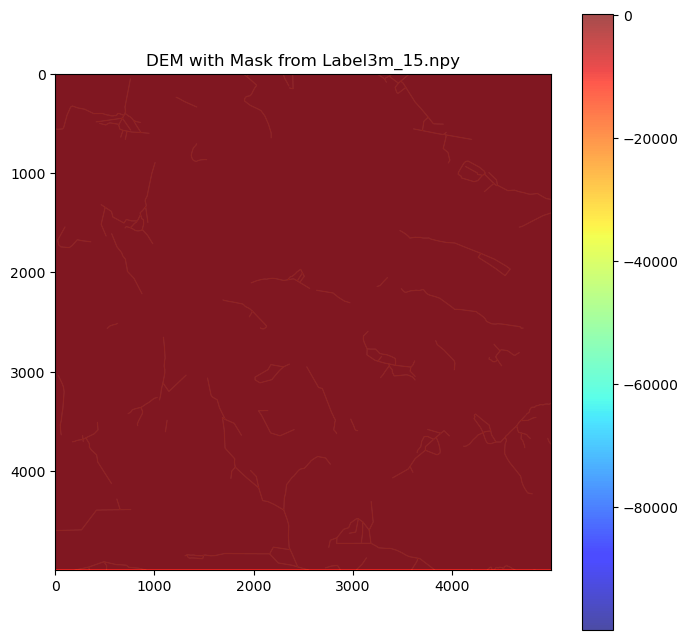

Accuracy for DEM with mask Label3m_15.npy: 0.0101


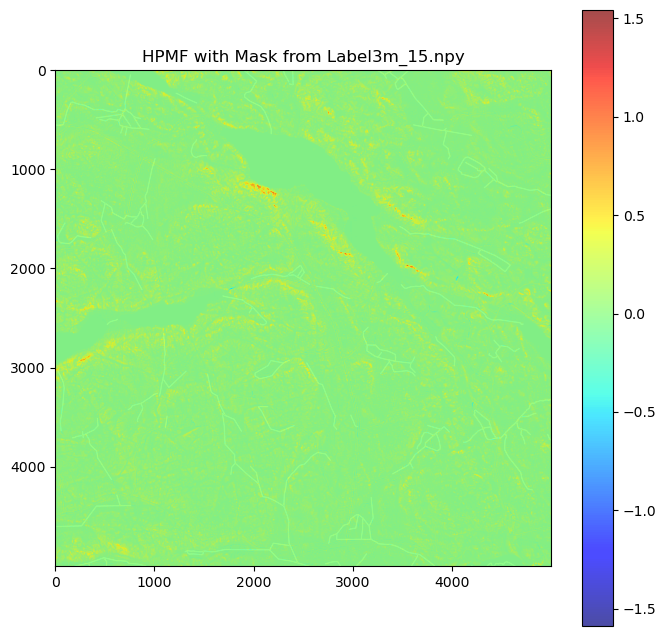

Accuracy for HPMF with mask Label3m_15.npy: 0.0133


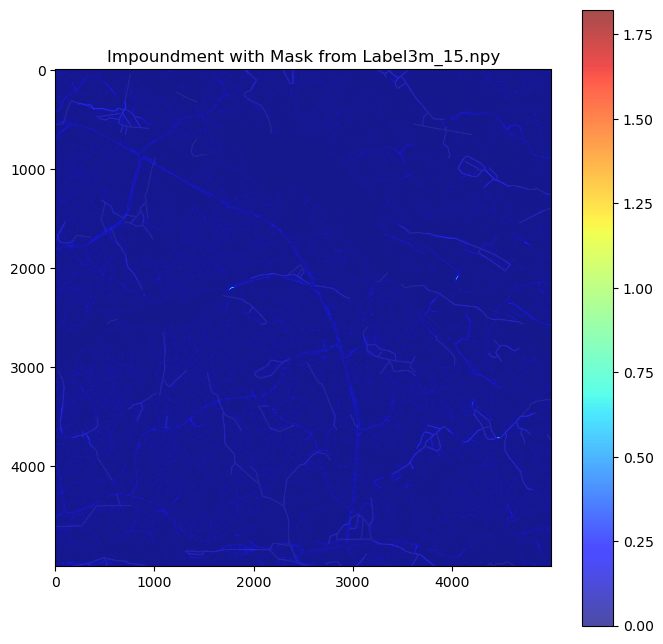

Accuracy for Impoundment with mask Label3m_15.npy: 0.3901


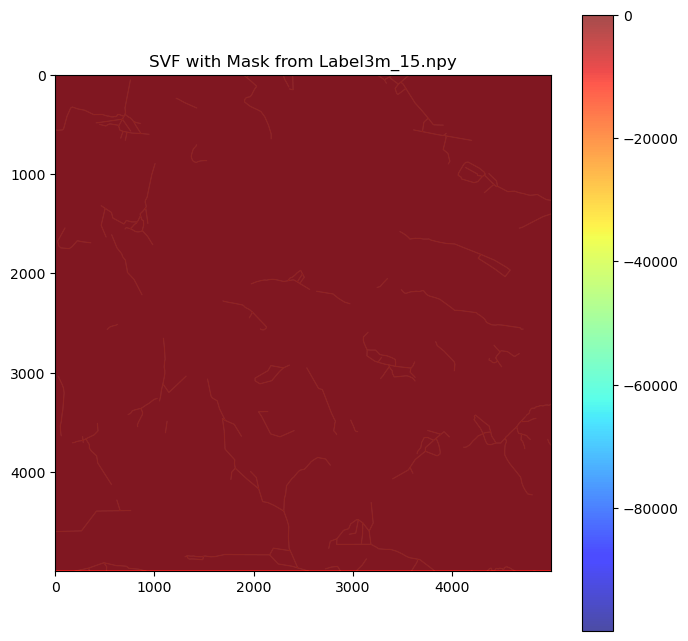

Accuracy for SVF with mask Label3m_15.npy: 0.0101


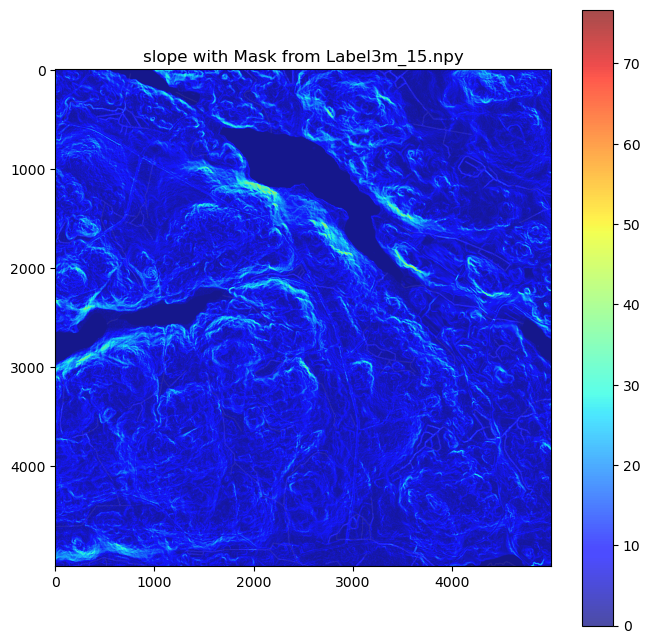

Accuracy for slope with mask Label3m_15.npy: 0.2777
Processing mask: Label3m_16.npy


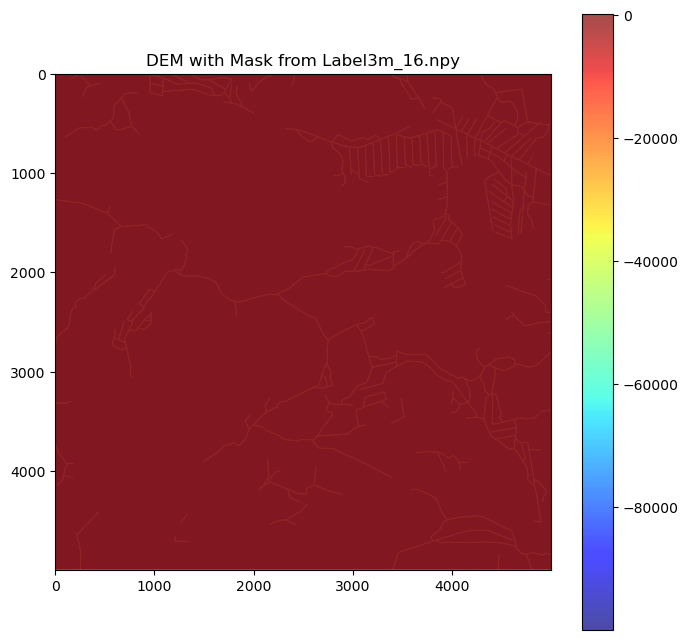

Accuracy for DEM with mask Label3m_16.npy: 0.0186


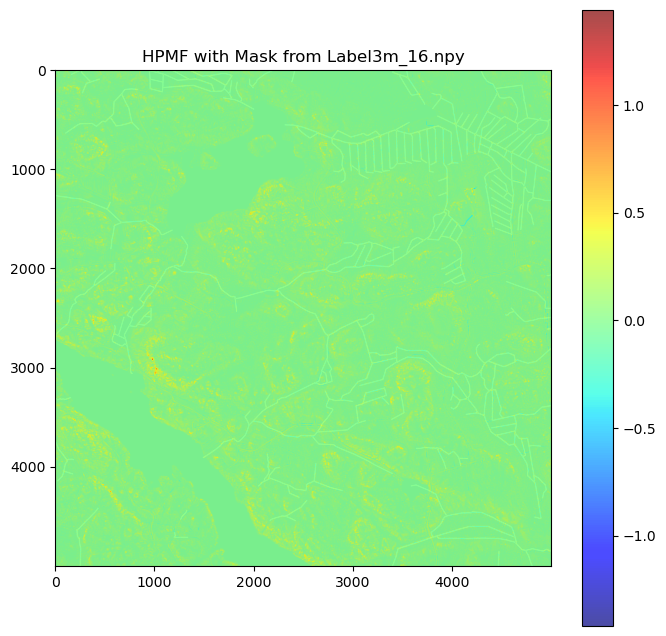

Accuracy for HPMF with mask Label3m_16.npy: 0.0221


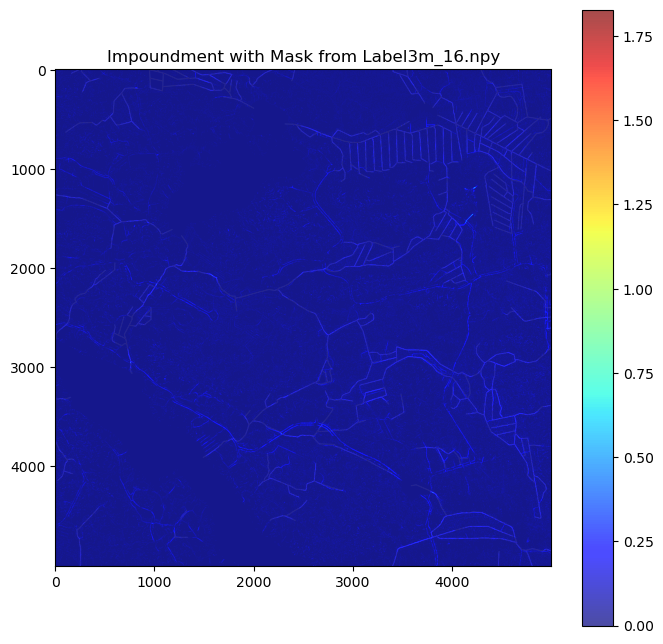

Accuracy for Impoundment with mask Label3m_16.npy: 0.3554


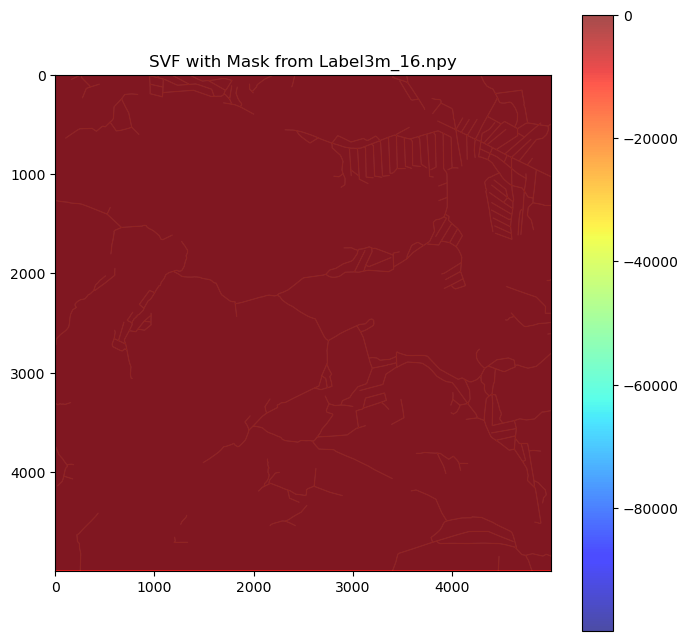

Accuracy for SVF with mask Label3m_16.npy: 0.0186


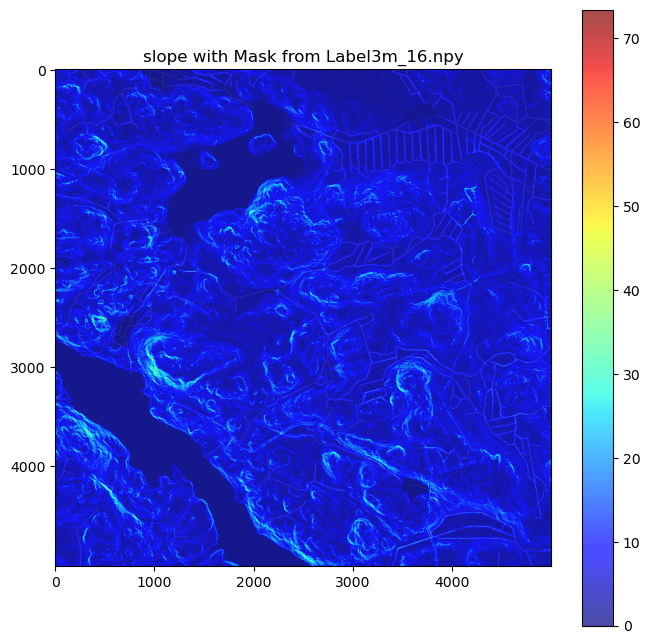

Accuracy for slope with mask Label3m_16.npy: 0.3002
Processing mask: Label3m_17.npy


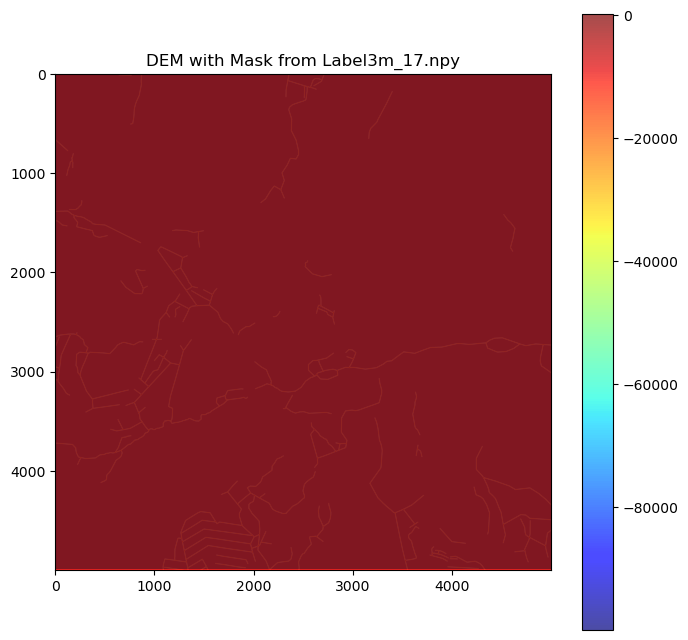

Accuracy for DEM with mask Label3m_17.npy: 0.0127


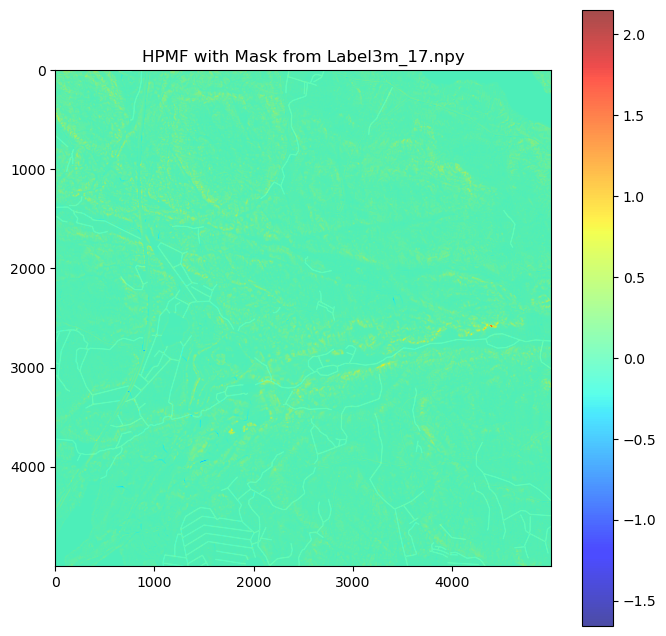

Accuracy for HPMF with mask Label3m_17.npy: 0.0168


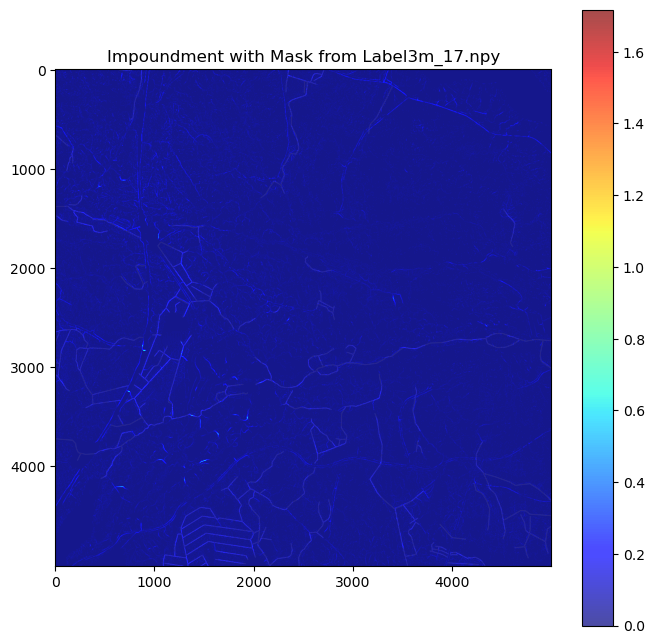

Accuracy for Impoundment with mask Label3m_17.npy: 0.4392


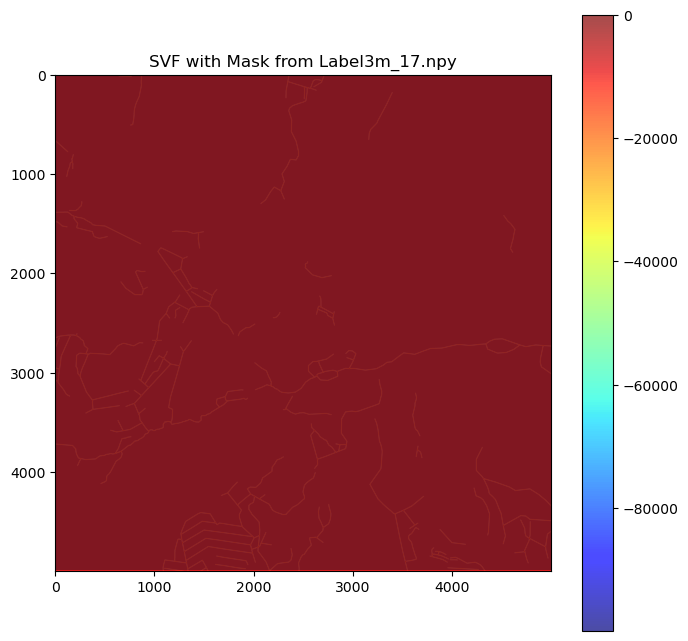

Accuracy for SVF with mask Label3m_17.npy: 0.0127


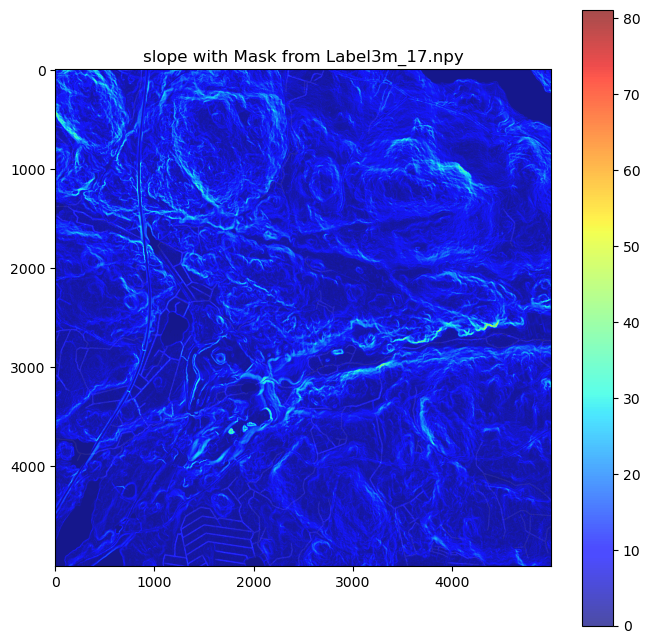

Accuracy for slope with mask Label3m_17.npy: 0.2694
Processing mask: Label3m_18.npy


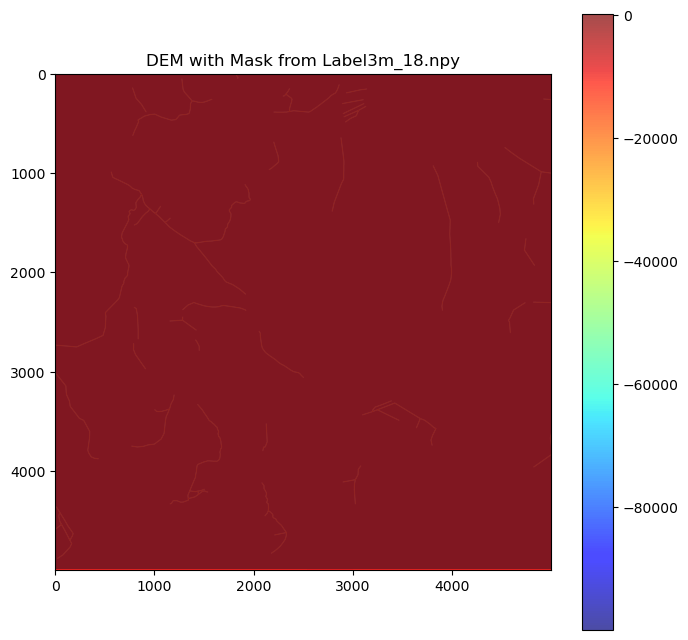

Accuracy for DEM with mask Label3m_18.npy: 0.0062


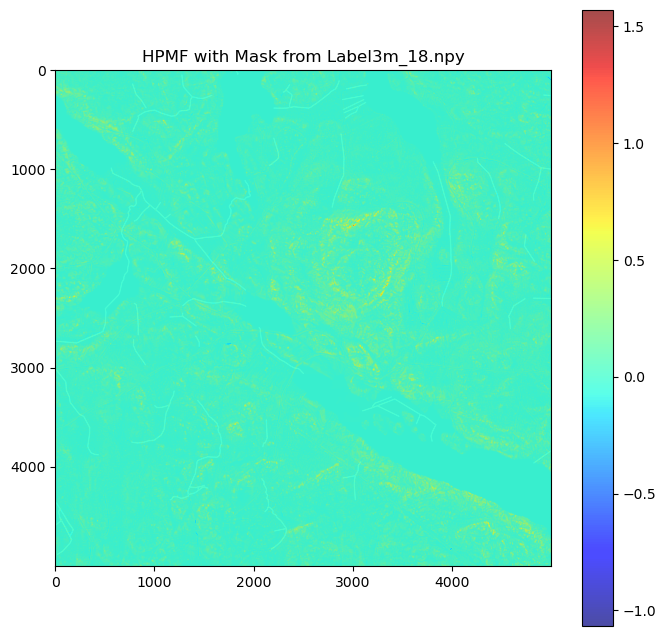

Accuracy for HPMF with mask Label3m_18.npy: 0.0145


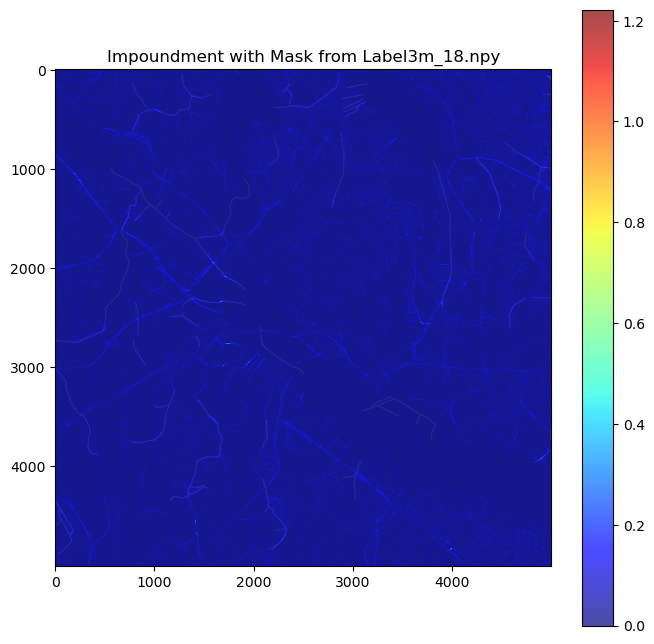

Accuracy for Impoundment with mask Label3m_18.npy: 0.4425


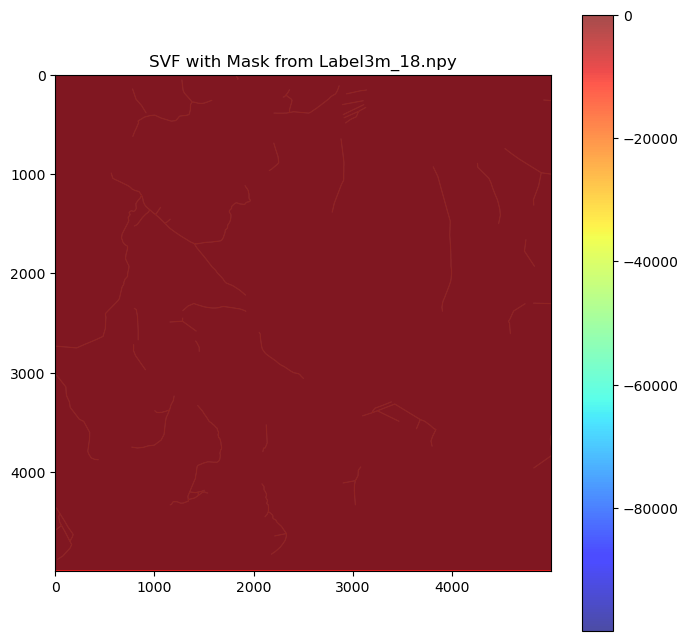

Accuracy for SVF with mask Label3m_18.npy: 0.0062


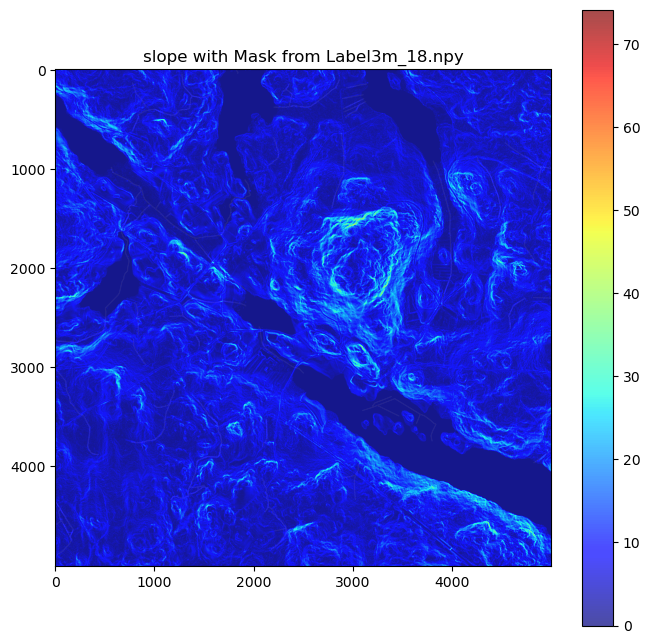

Accuracy for slope with mask Label3m_18.npy: 0.2995
Processing mask: Label3m_19.npy


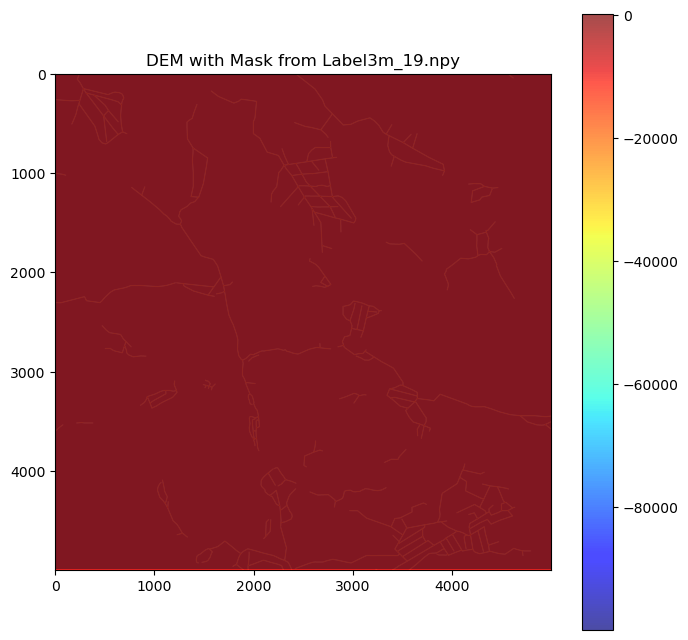

Accuracy for DEM with mask Label3m_19.npy: 0.0145


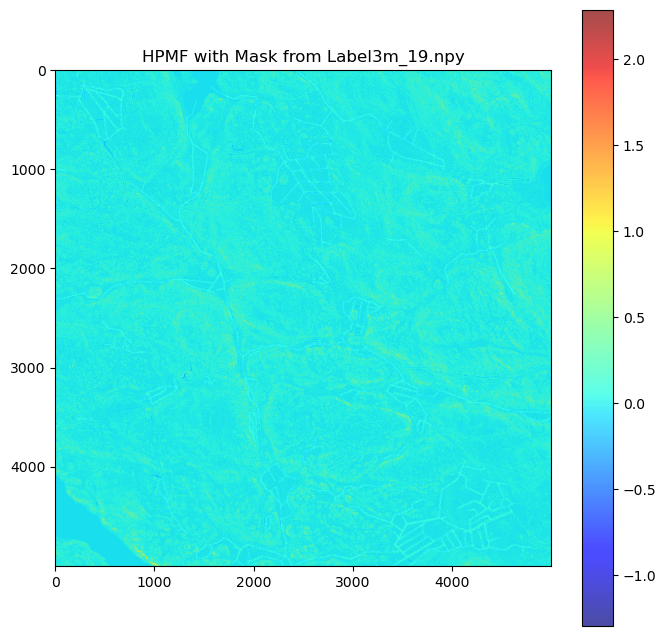

Accuracy for HPMF with mask Label3m_19.npy: 0.0186


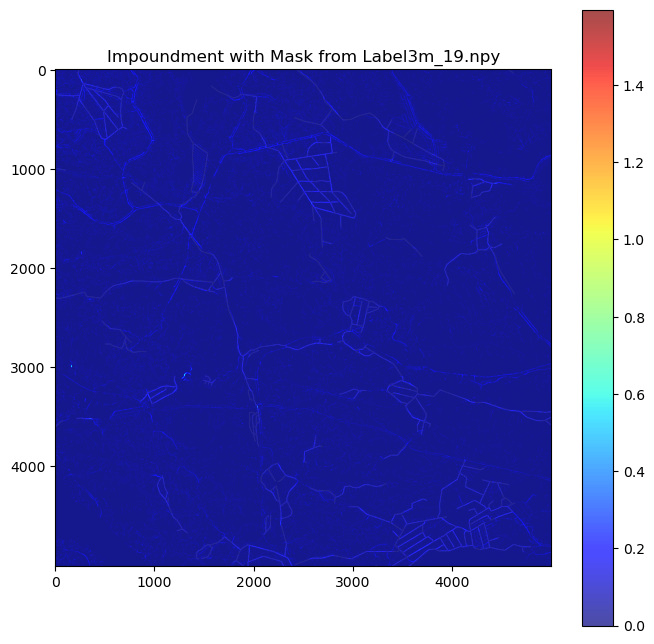

Accuracy for Impoundment with mask Label3m_19.npy: 0.4198


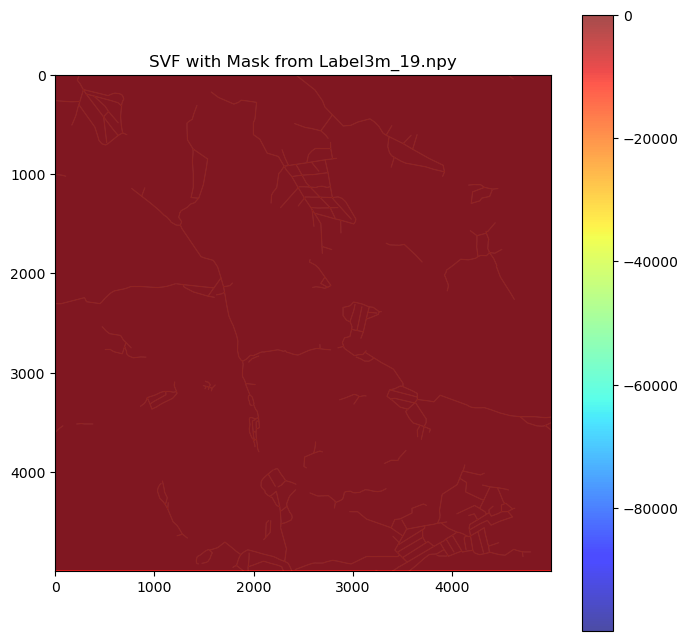

Accuracy for SVF with mask Label3m_19.npy: 0.0145


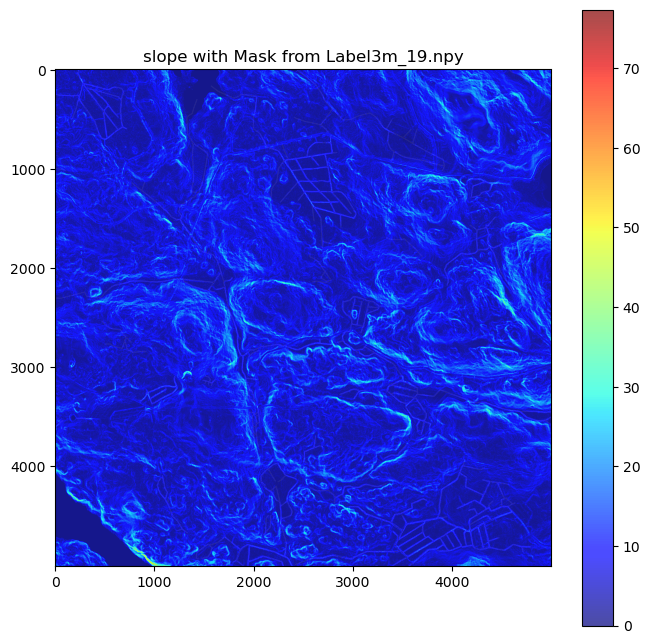

Accuracy for slope with mask Label3m_19.npy: 0.2667
Processing mask: Label3m_20.npy


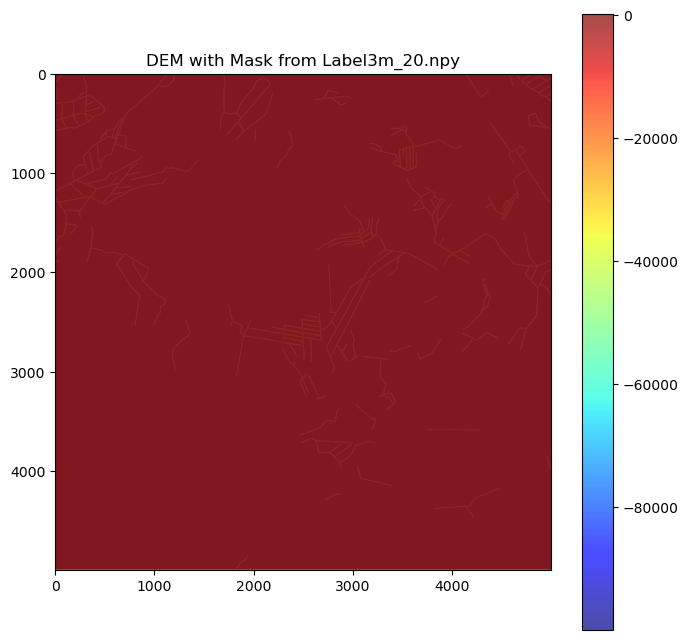

Accuracy for DEM with mask Label3m_20.npy: 0.0141


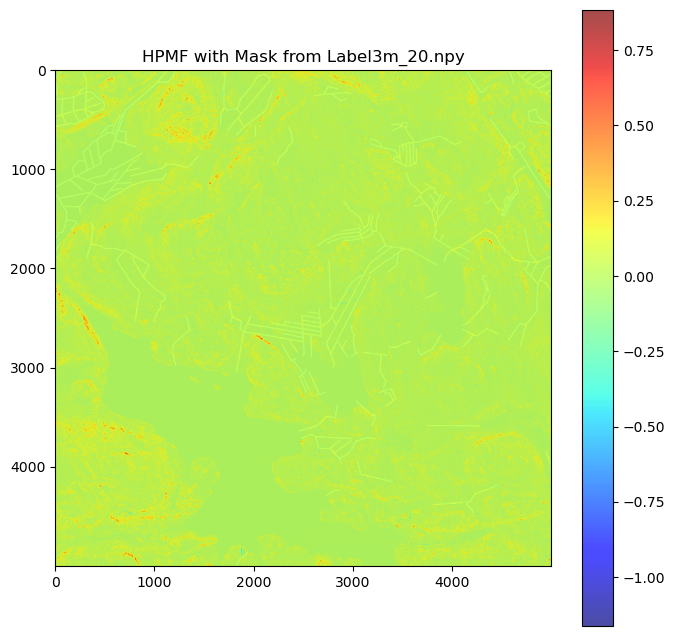

Accuracy for HPMF with mask Label3m_20.npy: 0.0282


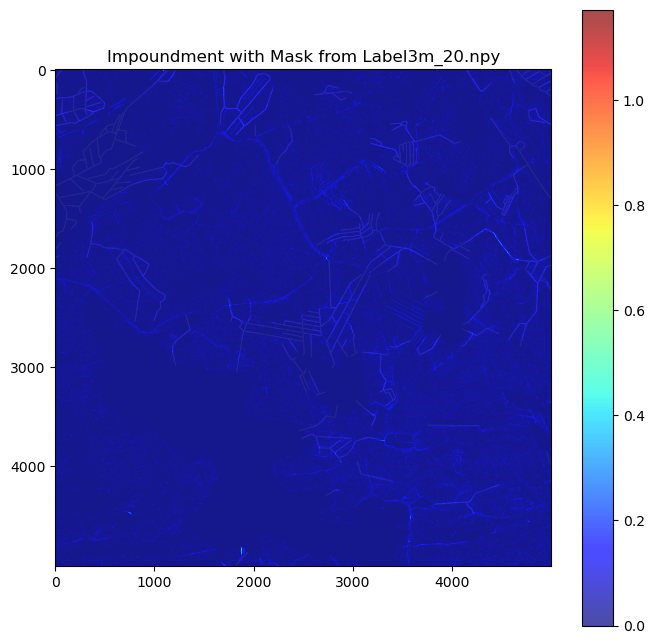

Accuracy for Impoundment with mask Label3m_20.npy: 0.3522


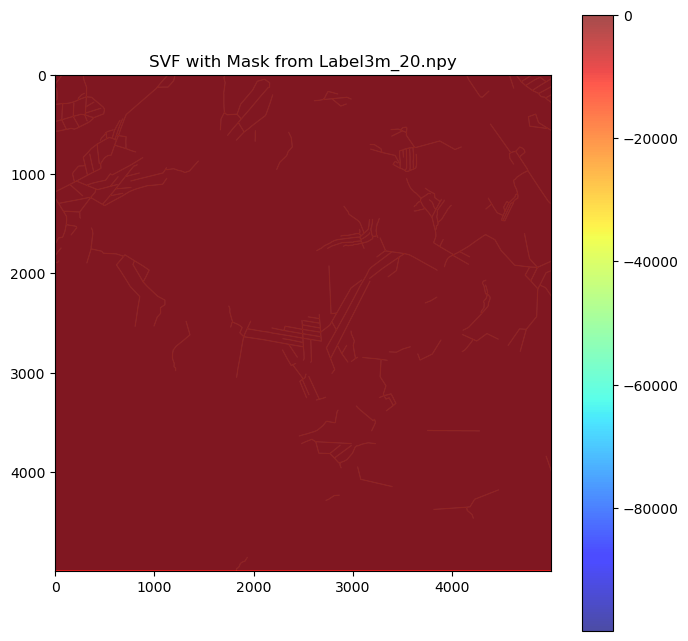

Accuracy for SVF with mask Label3m_20.npy: 0.0141


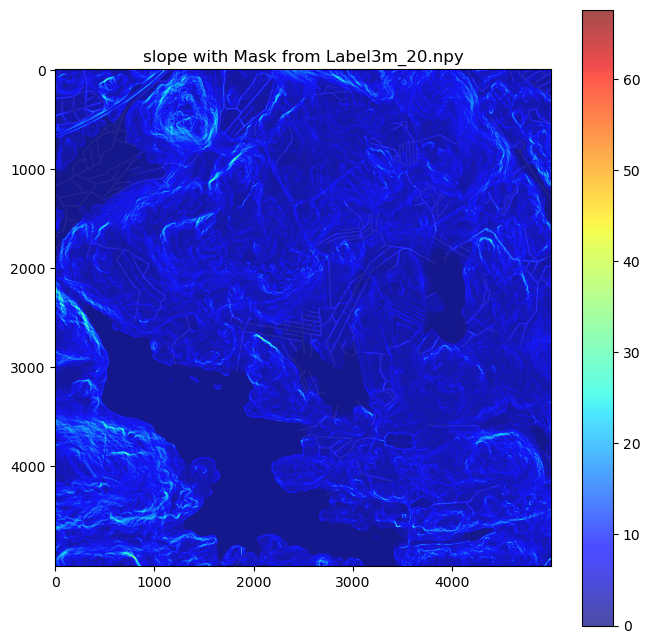

Accuracy for slope with mask Label3m_20.npy: 0.3244
Processing mask: Label3m_21.npy


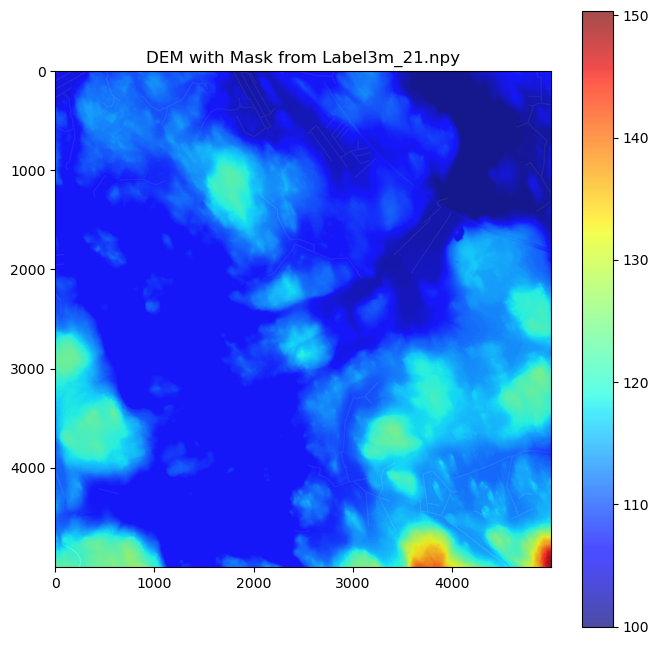

Accuracy for DEM with mask Label3m_21.npy: 0.0065


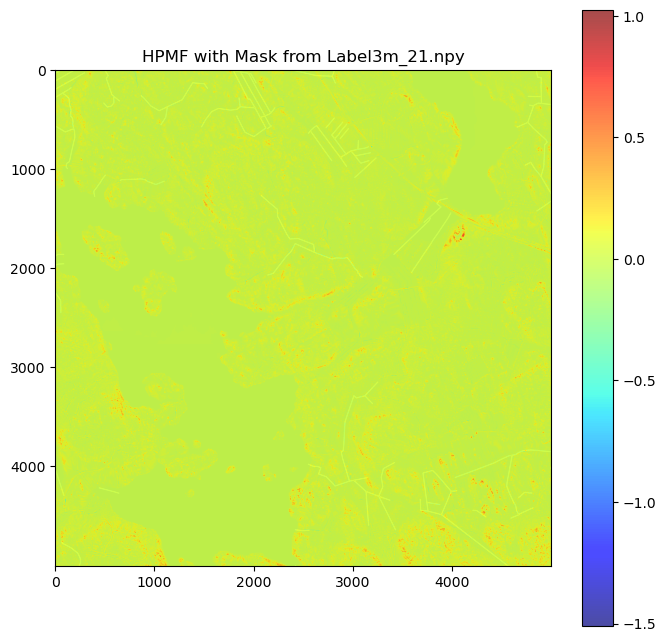

Accuracy for HPMF with mask Label3m_21.npy: 0.0224


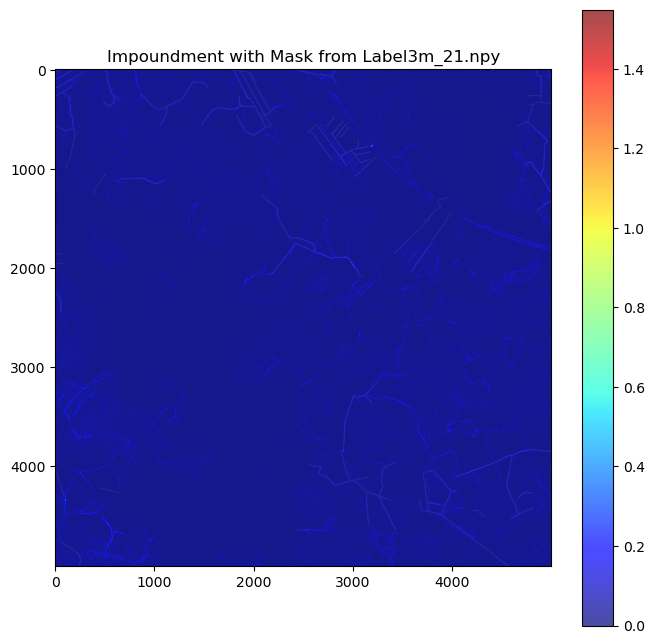

Accuracy for Impoundment with mask Label3m_21.npy: 0.3964


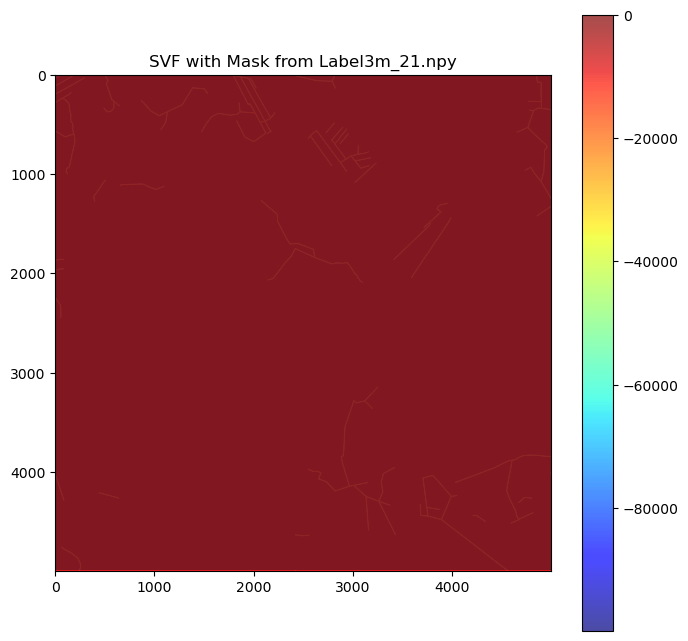

Accuracy for SVF with mask Label3m_21.npy: 0.0065


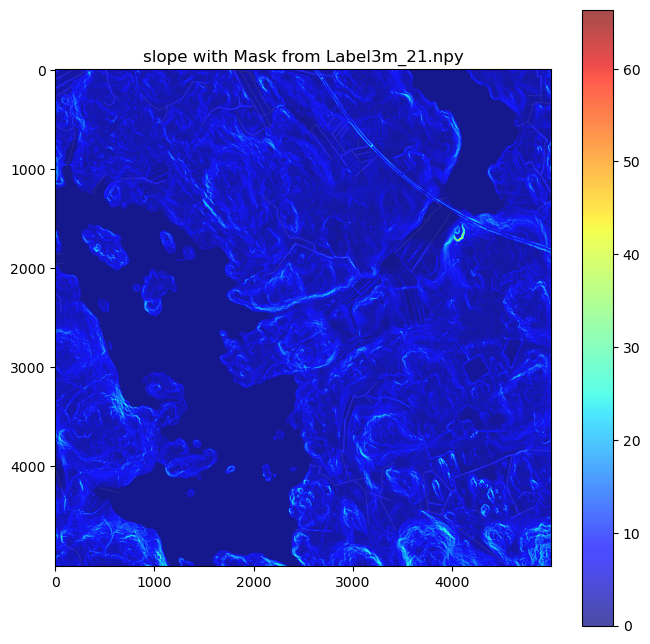

Accuracy for slope with mask Label3m_21.npy: 0.3552


In [40]:
import numpy as np
import matplotlib.pyplot as plt
import os

# Directories for data (adjust to the correct paths in your project)
data_dir = '../../01_Data/01_Raw/features/features'  # Replace with your actual path for dataset images (e.g., DEM, HPMF)
label3m_dir = '../../01_Data/01_Raw/features/features'  # Adjust to where your Label3m files are stored

# Define the range of Label3m files numbered from 1 to 21
label3m_files = [f"Label3m_{i}.npy" for i in range(1, 22)]  # Files from Label3m_1.npy to Label3m_21.npy

# Loop through each Label3m file
for label_file in label3m_files:
    mask_path = os.path.join(label3m_dir, label_file)
    
    # Load the Label3m mask
    mask_data = np.load(mask_path)
    print(f"Processing mask: {label_file}")
    
    # Loop through corresponding dataset names (e.g., DEM, HPMF, etc.)
    for dataset_name in ['DEM', 'HPMF', 'Impoundment', 'SVF', 'slope']:  # Add more dataset names here if necessary
        # Extract the numerical index from the Label3m filename (e.g., Label3m_1.npy -> 1)
        index = int(label_file.split('_')[1].split('.')[0]) - 1  # Adjust for zero-indexed numpy array
        
        # Construct the filename for each dataset based on the current Label3m index
        dataset_file = os.path.join(data_dir, f"{dataset_name}_{index+1}.npy")  # +1 to match the expected index in file names
        
        if not os.path.exists(dataset_file):  # Check if the dataset file exists
            print(f"Warning: Dataset file {dataset_file} not found. Skipping this file.")
            continue
        
        # Load the dataset image (e.g., DEM, HPMF, etc.)
        dataset_data = np.load(dataset_file)
        
        # Ensure dataset size matches mask size
        if dataset_data.shape != mask_data.shape:
            print(f"Shape mismatch for {dataset_name} and {label_file}. Skipping this file.")
            continue
        
        # Calculate accuracy: count how many valid pixels in the mask correspond to data points in the region
        true_positive = np.sum((mask_data == 1) & (dataset_data != 0))
        false_positive = np.sum((mask_data == 1) & (dataset_data == 0))
        true_negative = np.sum((mask_data == 0) & (dataset_data == 0))
        false_negative = np.sum((mask_data == 0) & (dataset_data != 0))

        accuracy = (true_positive + true_negative) / (true_positive + false_positive + true_negative + false_negative)
        
        # Plot the dataset image and overlay the mask
        fig, ax = plt.subplots(figsize=(8, 8))
        
        # Show dataset image
        ax.imshow(dataset_data, cmap='jet', alpha=0.7)  # The 'jet' colormap is just an example, you can use others.
        
        # Overlay the mask as semi-transparent
        ax.imshow(mask_data, cmap='coolwarm', alpha=0.3)  # Mask overlay with transparency
        
        ax.set_title(f"{dataset_name} with Mask from {label_file}")
        plt.colorbar(ax.imshow(dataset_data, cmap='jet', alpha=0.7), ax=ax, orientation='vertical')
        plt.show()

        print(f"Accuracy for {dataset_name} with mask {label_file}: {accuracy:.4f}")


### Viewing out the Impundment Size index with the mask Layer of Label3m

nOte: the image needs to be zoomed out, there color differences inside the stream lines. 

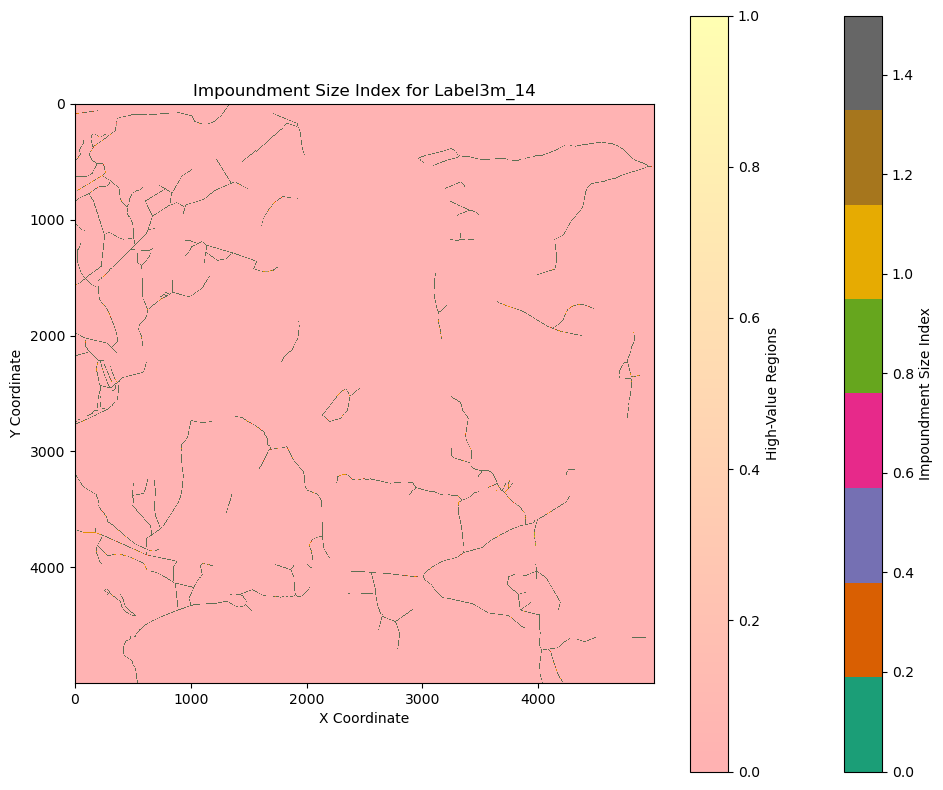

Summary for Label3m_14:
  Max Value: 1.5186512470245361
  Mean Value: 0.056481704115867615
  Threshold (95th Percentile): 0.20278194546699524


In [19]:
import numpy as np
import matplotlib.pyplot as plt
import os

# Define file paths
impoundment_file_template = '../../01_Data/01_Raw/features/features/Impoundment_{}.npy'
mask_file_template = '../../01_Data/01_Raw/features/features/Label3m_{}.npy'

# Choose a specific mask (e.g., Label3m_14.npy)
label_index = 14
impoundment_file = impoundment_file_template.format(label_index)
mask_file = mask_file_template.format(label_index)

# Load the impoundment data and mask
impoundment_data = np.load(impoundment_file)
mask = np.load(mask_file)

# Apply the mask to the impoundment data
masked_impoundment = np.where(mask, impoundment_data, np.nan)  # Replace non-masked values with NaN

# Filter high values (e.g., top 5% of values)
valid_data = masked_impoundment[~np.isnan(masked_impoundment)]  # Remove NaNs
threshold = np.percentile(valid_data, 95)  # Top 5% threshold
high_value_regions = masked_impoundment >= threshold

# Plot the data
plt.figure(figsize=(10, 8))

# Plot impoundment data (masked)
plt.imshow(masked_impoundment, cmap='Dark2', interpolation='nearest')
plt.colorbar(label='Impoundment Size Index')
plt.title(f"Impoundment Size Index for Label3m_{label_index}")
plt.xlabel('X Coordinate')
plt.ylabel('Y Coordinate')

# Overlay high-value regions
plt.imshow(high_value_regions, cmap='autumn', alpha=0.3, interpolation='nearest')
plt.colorbar(label='High-Value Regions')

# Save or display the plot
plt.tight_layout()
plt.show()

# Optional: Print summary statistics
print(f"Summary for Label3m_{label_index}:")
print(f"  Max Value: {np.nanmax(masked_impoundment)}")
print(f"  Mean Value: {np.nanmean(masked_impoundment)}")
print(f"  Threshold (95th Percentile): {threshold}")
